In [1]:
import pandas as pd
pd.set_option('display.max_columns', None)
pd.options.mode.chained_assignment = None
import matplotlib.pyplot as plt
from matplotlib.dates import DateFormatter
from matplotlib.patches import Rectangle
import numpy as np
import datetime as dt
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
import seaborn as sns
sns.set_style("whitegrid")
sns.set_context("paper")
import folium
from folium.features import DivIcon
from scipy.fft import fft, fftfreq
from scipy.interpolate import interp1d
import scipy.stats as stats
import statsmodels.formula.api as smf
import statsmodels.api as sm

# 1. Reading and cleaning the data

## 1.1. Reading the data

In [2]:
def structure_data(filepath, year, month):
    ## Getting the filepaths
    # NO2
    no2_filepath = filepath+"/"+month+"_mo"+str(year)[-2:]+".csv"
    # Weather
    weather_filepath = filepath+"/"+month+"_meteo"+str(year)[-2:]+".csv"
    
    ## Cleaned dataset
    cleaned = []
    
    ## Reading no2 data
    no2_data = pd.read_csv(no2_filepath, sep = ";")
    no2_data = no2_data[no2_data["MAGNITUD"]==8]
    
    ## Selecting data
    for row in no2_data.iterrows():
        
        # Loop over hours
        for i in range (1,25):
            # DATE
            # Extracting date
            cleaned_row = []
            year = str(row[1].loc["ANO"])
            month = str(row[1].loc["MES"])
            day = str(row[1].loc["DIA"])
            hour = str(i-1)
            date = year + "-" + month + "-" + day + " " + hour + ":00"
            date = dt.datetime.strptime(date, "%Y-%m-%d %H:%M")
            
            # Adding date
            cleaned_row.append(date) #Date
            cleaned_row.append(row[1].loc["MES"]) #Month
            cleaned_row.append(row[1].loc["DIA"]) #Day
            cleaned_row.append(i-1) #Hour
            
            # DATA
            if i<10:
                data_col = "H0"+str(i)
                data_ver = "V0"+str(i)
                if row[1].loc[data_ver] == "V":
                    cleaned_row.append(row[1].loc[data_col])
                else:
                    cleaned_row.append(np.nan)
            else:
                data_col = "H"+str(i)
                data_ver = "V"+str(i)
                if row[1].loc[data_ver] == "V":                        
                    cleaned_row.append(row[1].loc[data_col])
                else:
                    cleaned_row.append(np.nan)
            
            # STATION ID
            cleaned_row.append(row[1].loc["PUNTO_MUESTREO"].split("_")[0][-3:])
            
            #Final list
            cleaned.append(cleaned_row)
           
    # Final dataset
    month_df = pd.DataFrame(cleaned, columns = ["Date","Month","Day","Hour","NO2","StationID"])
    
    ## ADDING WEATHER DATA
    weather_data = pd.read_csv(weather_filepath, sep = ";")
    variables = ["Wind", "Temperature", "Humidity","Pressure","Solar","Precipitation"]
    code = [81,83,86,87,88,89]
    for i in range(len(code)):
        col = variables[i]
        month_df[col] = np.nan
        magnitud = weather_data[weather_data["MAGNITUD"]==code[i]]
        for row in magnitud.iterrows():

            # Get station ID
            station = row[1].loc["PUNTO_MUESTREO"].split("_")[0][-3:]

            # Filter stations
            if station in month_df["StationID"].unique():
                station_filter = month_df["StationID"] == station

                # Loop over hours
                for i in range(1,25):
                    year = str(row[1].loc["ANO"])
                    month = str(row[1].loc["MES"])
                    day = str(row[1].loc["DIA"])
                    hour = str(i-1)
                    date = year + "-" + month + "-" + day + " " + hour + ":00"
                    date = dt.datetime.strptime(date, "%Y-%m-%d %H:%M")   
                    date_filter = month_df["Date"] == date

                    # Select this row
                    total_filter = station_filter & date_filter

                    # Select this value
                    # DATA
                    if i<10:
                        data_col = "H0"+str(i)
                        data_ver = "V0"+str(i)
                        if row[1].loc[data_ver] == "V":
                            month_df.loc[total_filter,col] = row[1].loc[data_col]
                        else:
                            pass
                    else:
                        data_col = "H"+str(i)
                        data_ver = "V"+str(i)
                        if row[1].loc[data_ver] == "V":                        
                            month_df.loc[total_filter,col] = row[1].loc[data_col]
                        else:
                            pass 
   
    ## FILLING MISSING VALUES WITH THE MEAN
    for date in month_df["Date"].unique():
        for col in ["NO2","Wind","Temperature","Humidity","Pressure","Solar","Precipitation"]:
            mean_value = month_df.loc[month_df["Date"]==date,col].mean()
            month_df.loc[month_df["Date"]==date,col] = month_df.loc[month_df["Date"]==date,col] \
            .fillna(mean_value)
    return month_df

In [3]:
def get_year(filepath, year):
    final_df = pd.DataFrame()
    for month in ["mar", "abr", "may", "jun"]:
        df = structure_data(filepath, year, month)
        final_df = final_df.append(df)
    final_df = final_df.sort_values(["StationID","Date"]).reset_index(drop = True)
    final_df = final_df.fillna(method = "ffill").fillna(method = "bfill")
    return final_df

In [4]:
def get_dataset(filepath):
    # Read both years
    data_2019 = get_year(filepath, 2019)
    data_2020 = get_year(filepath, 2020)
    
    # Concatenate datasets
    data_final = pd.concat([data_2019,data_2020]).sort_values(["Date","StationID"]).reset_index(drop=True) 
   
    # Add year
    data_final["Year"] = data_final["Date"].dt.year

    # Add lockdown    
    start = dt.datetime(year=2020,month=3,day=10)
    end = dt.datetime(year=2020,month=6,day=21)
    data_final["Lockdown"] = data_final["Date"].apply(lambda x: int(x>=start and x<=end))
    
    # Add weekday
    data_final["Weekday"] = data_final["Date"].dt.weekday
    
    return data_final

After cleaning, the dataset is saved as a csv file: "data_final.csv". 

In [5]:
data_final = pd.read_csv("DataSets/data_final.csv")
data_final["Date"] = pd.to_datetime(data_final["Date"])

## 1.2. Outlier detection

### 1.2.1. Wrong meassures of data

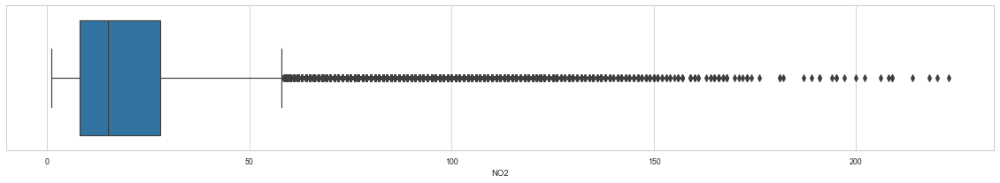

In [6]:
f, ax = plt.subplots(figsize = (20,3))
sns.boxplot(data_final["NO2"], ax = ax)

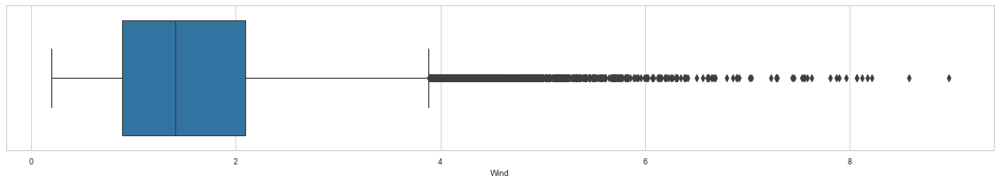

In [7]:
f, ax = plt.subplots(figsize = (20,3))
sns.boxplot(data_final["Wind"], ax = ax)

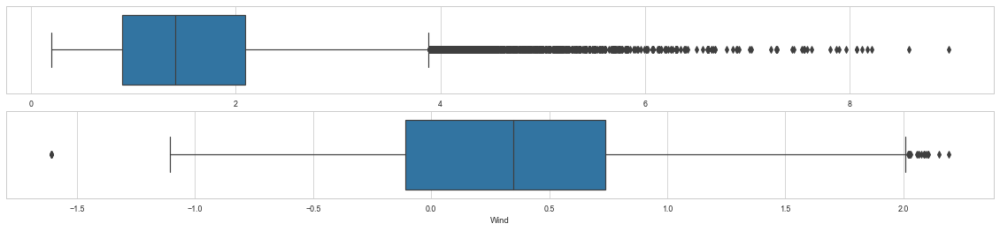

In [8]:
f, ax = plt.subplots(figsize = (20,4), nrows = 2)
sns.boxplot(data_final["Wind"], ax = ax[0])
sns.boxplot(np.log(data_final["Wind"]), ax = ax[1])

The log of wind speed shows outliers better than the raw data:

In [9]:
wind_filter = (np.log(data_final["Wind"])>-1.5) & (np.log(data_final["Wind"])<2)
np.sum(~wind_filter)

23

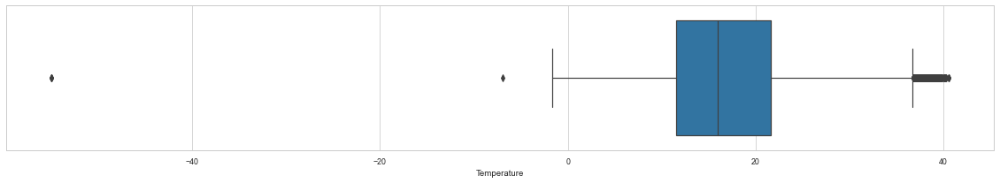

In [10]:
f, ax = plt.subplots(figsize = (20,3))
sns.boxplot(data_final["Temperature"], ax = ax)

In [11]:
temp_filter = data_final["Temperature"]>-20
np.sum(~temp_filter)

3

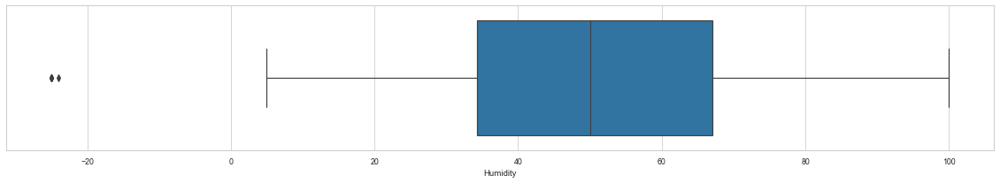

In [12]:
f, ax = plt.subplots(figsize = (20,3))
sns.boxplot(data_final["Humidity"], ax = ax)

Relative humidity must be above 0. 

In [13]:
hum_filter = data_final["Humidity"]>0
np.sum(~hum_filter)

6

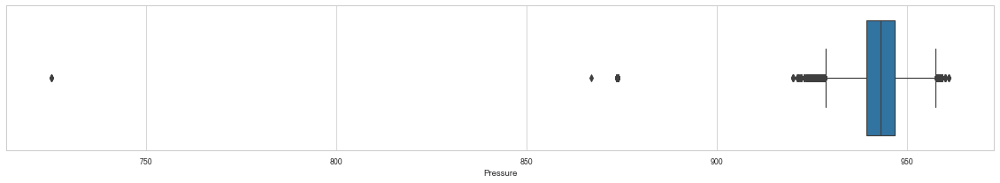

In [14]:
f, ax = plt.subplots(figsize = (20,3))
sns.boxplot(data_final["Pressure"], ax = ax)

Pressures bellow 900mb will not be considered:

In [15]:
pres_filter = data_final["Pressure"]>900
np.sum(~pres_filter)

67

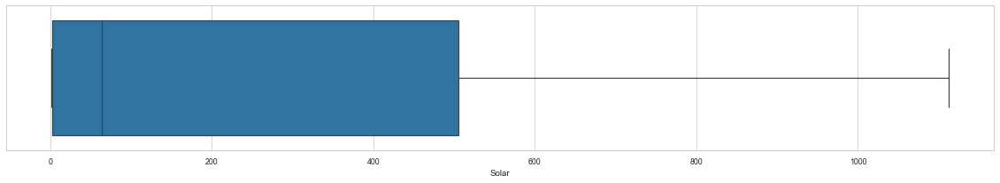

In [16]:
f, ax = plt.subplots(figsize = (20,3))
sns.boxplot(data_final["Solar"], ax = ax)

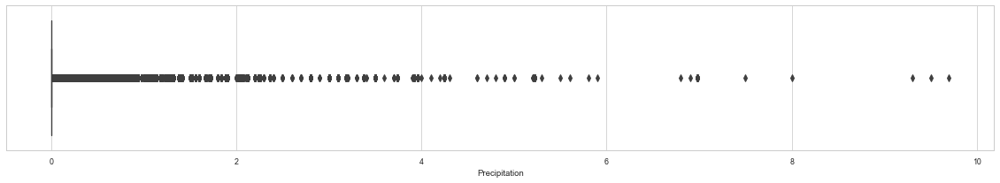

In [17]:
f, ax = plt.subplots(figsize = (20,3))
sns.boxplot(data_final["Precipitation"], ax = ax)

In [18]:
data_woo = data_final[wind_filter & temp_filter & hum_filter & pres_filter]

In [19]:
len(data_woo)/len(data_final)

0.9993521078092605

### 1.2.2. Mahalanobis distance and outliers

In [20]:
from sklearn.preprocessing import StandardScaler
def mahalanobis(data):
    scaler = StandardScaler()
    data = pd.DataFrame(scaler.fit_transform(data))
    data_mean = data-data.mean()
    cov = np.cov(data.values.T)
    inv_covmat = np.linalg.inv(cov)
    left_term = np.matmul(data_mean, inv_covmat).to_numpy()
    dist = []
    for i in range(left_term.shape[0]):
        dist.append(np.matmul(left_term[i,:], data_mean.values.T[:,i]))
    return dist

In [21]:
data_woo["Mahalanobis"] = mahalanobis(data_woo.drop(["Date","Precipitation"], axis=1))

1.5 times away from the interquantile range:

In [22]:
def isoutlier1(data, column):
    (q1, q3)=data[column].quantile([0.25,0.75])
    iqr = q3 - q1
    maxwhis = q3 + 1.5 * iqr
    minwhis = q1 - 1.5 * iqr
    return (data[column]>=maxwhis) | (data[column]<=minwhis)

In [23]:
data_woo["OutlierM1"] = isoutlier1(data_woo, "Mahalanobis")
data_woo["OutlierM1"].sum()/len(data_woo)*100

3.761651611416058

2 stds from the mean:

In [24]:
def isoutlier2(data, column, dist = 2):
    mean = data[column].mean()
    std = data[column].std()
    maxdata = mean + dist * std
    mindata = mean - dist * std
    return (data[column]>=maxdata) | (data[column]<=mindata)

In [25]:
data_woo["OutlierM2"] = isoutlier2(data_woo, "Mahalanobis")
data_woo["OutlierM2"].sum()/len(data_woo)*100

3.5419458010978087

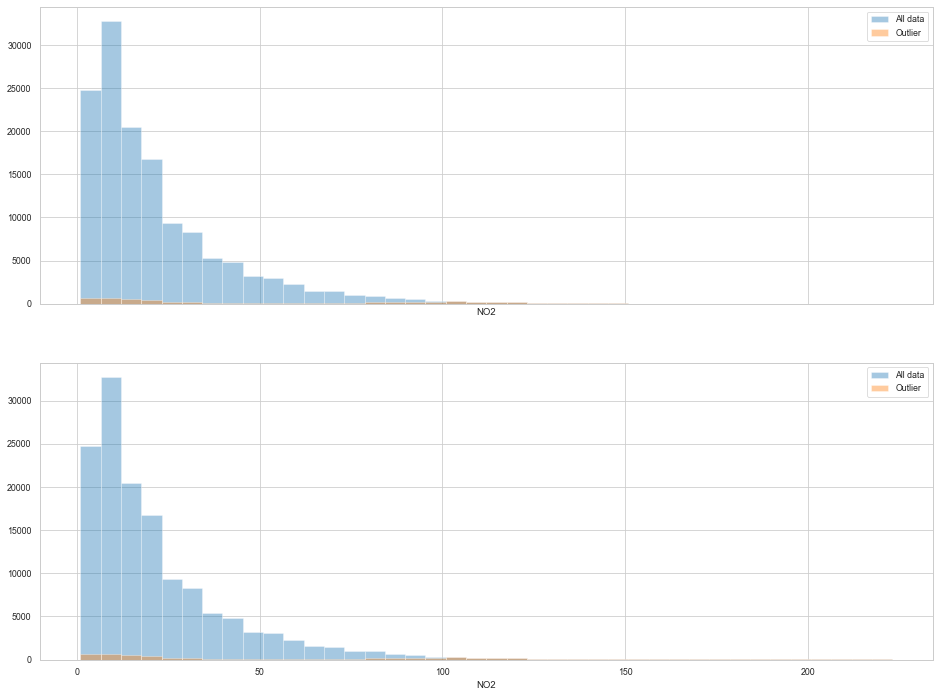

In [26]:
f, ax = plt.subplots(figsize = (16,12), nrows = 2, sharex = True)
sns.distplot(data_woo["NO2"], ax = ax[0], kde=False, label = "All data", bins = 40)
sns.distplot(data_woo[data_woo["OutlierM1"]==1]["NO2"], ax = ax[0], kde=False, label = "Outlier",
            bins = 40)
sns.distplot(data_woo["NO2"], ax = ax[1], kde=False, label = "All data", bins = 40)
sns.distplot(data_woo[data_woo["OutlierM2"]==1]["NO2"], ax = ax[1], kde=False, label = "Outlier",
            bins = 40)
ax[0].legend()
ax[1].legend()

Removing outliers found with the Mahalanobis distance.

In [27]:
data_cleaned = data_woo[data_woo["OutlierM1"]==0][["Date","Year","Lockdown","Month","Weekday","Day","Hour",
                                               "Wind","Temperature","Humidity","Pressure","Solar",
                                                "Precipitation", "StationID","NO2"]].copy()

# 2. Station spatialisation

Useful for visualisations and pattern recognition

In [28]:
spatialisation = data_cleaned[["Year","StationID","NO2"]] \
                .groupby(["Year","StationID"]).mean().reset_index()
stations = pd.pivot_table(spatialisation, values='NO2', index=['StationID'], columns=['Year']) \
            .reset_index()
stations["Diff"] = stations[2019]-stations[2020]
stations["Fraction"] = stations["Diff"]/stations[2019]

In [29]:
import math
def getColor (x, y, minX, maxX, minY, maxY):
    wX=maxX-minX 
    wY=maxY-minY
    rr=y-minY 
    cc=x-minX
    #print(x,y)
    if (wY < wX):   #scale vertically, i.e. modify rr
        rr *= wX/wY  
    else:           #scale horizontally, i.e. modify cc
        cc *= wY/wX
    maxD=max(wX,wY)
    rr1=maxD-rr
    cc1=maxD-cc
    #print(rr,cc,maxD,rr1,cc1)
    dc=[math.sqrt(rr*rr+cc*cc),math.sqrt(rr*rr+cc1*cc1),math.sqrt(rr1*rr1+cc*cc),
        math.sqrt(rr1*rr1+cc1*cc1)]
    weights=[0.0,0.0,0.0,0.0]
    for i in range(len(weights)):
        weights[i]=(maxD-dc[i])/maxD
        if (weights[i]<0):
            weights[i]=0
    #print(dc,weights)
    reds=[228,25,255,37]
    greens=[220,228,18,13]
    blues=[0,218,6,252]
    dr=0
    dg=0
    db=0
    for i,weight in enumerate(weights):
        dr += weight*reds[i]
        dg += weight*greens[i]
        db += weight*blues[i]
    if (dr<0):
        dr=0;
    if (dr>255):
        dr=255
    if (dg<0):
        dg=0;
    if (dg>255):
        dg=255        
    if (db<0):
        db=0;
    if (db>255):
        db=255  
    #print(weights,dr,dg,db)
    c_string = '#{:02x}{:02x}{:02x}'.format(int(dr),int(dg),int(db))    
    return c_string

In [30]:
ss = StandardScaler()
stations_pca = ss.fit_transform(stations.drop("StationID", axis=1))
pca = PCA(n_components = 2, random_state=1492)
xy= pca.fit_transform(stations_pca)

In [31]:
pca.explained_variance_ratio_

array([0.64885283, 0.34946737])

In [32]:
pca.components_

array([[ 0.61193812,  0.4777292 ,  0.585819  ,  0.23264276],
       [ 0.14173353,  0.53873473, -0.2763871 , -0.78312621]])

In [33]:
palette_stations = []
for i in range(len(xy)):
    c = getColor(xy[i,0], xy[i,1], xy[:,0].min(), xy[:,0].max(), xy[:,1].min(), xy[:,1].max())
    palette_stations.append(c)

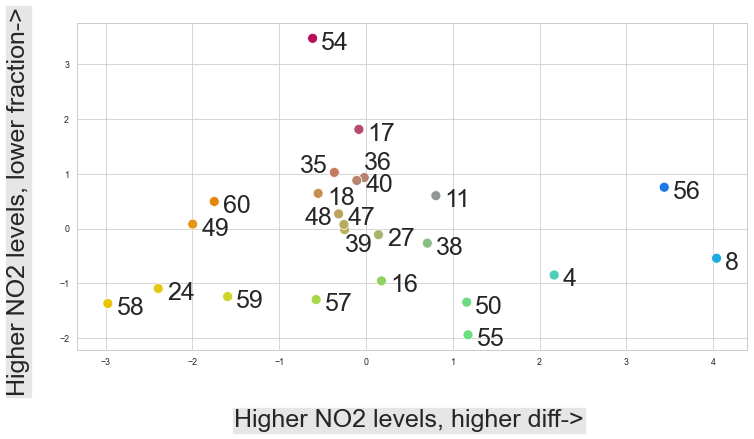

In [34]:
f, ax = plt.subplots(figsize=(12,6))
sns.scatterplot(x=xy[:,0], y=xy[:,1], hue=stations["StationID"], palette=palette_stations, s = 100)
ax.get_legend().remove()
for i in range(len(xy)):
    if stations["StationID"].to_list()[i]==48:
        plt.text(xy[i,0]-0.45, xy[i,1],stations["StationID"].to_list()[i], size = 25)
    elif stations["StationID"].to_list()[i]==39:
        plt.text(xy[i,0], xy[i,1]-0.4,stations["StationID"].to_list()[i], size = 25)
    elif stations["StationID"].to_list()[i]==35:
        plt.text(xy[i,0]-0.4, xy[i,1],stations["StationID"].to_list()[i], size = 25)
    elif stations["StationID"].to_list()[i]==36:
        plt.text(xy[i,0], xy[i,1]+0.15,stations["StationID"].to_list()[i], size = 25)
    else:
        plt.text(xy[i,0]+0.1, xy[i,1]-0.2,stations["StationID"].to_list()[i], size = 25)
    ax.text(-4, 0.5, 'Higher NO2 levels, lower fraction->', 
        {'ha': 'center', 'va': 'center', 'bbox': {'fc': '0.9', 'pad': 2}}, 
        rotation=90, size = 25)
    ax.text(0.5, -3.5, 'Higher NO2 levels, higher diff->', 
        {'ha': 'center', 'va': 'center', 'bbox': {'fc': '0.9', 'pad': 2}}, 
        rotation=0, size = 25)

In [35]:
stations_path = "DataSets/informacion_estaciones_red_calidad_aire.xls"
stations_inf = pd.read_excel(stations_path)

In [36]:
xmm=(stations_inf.LONGITUD.min()+stations_inf.LONGITUD.max())/2
ymm=(stations_inf.LATITUD.min()+stations_inf.LATITUD.max())/2
map1 = folium.Map(location=[ymm,xmm], zoom_start=12, width=700, height=800,
                tiles='Stamen Terrain')

for row in stations_inf.iterrows():
    point = [row[1]["LATITUD"], row[1]["LONGITUD"]]
    folium.Marker(point, icon=DivIcon(
        icon_size=(150,36),
        icon_anchor=(-10,25),
        html='<div style="font-size: 16pt; color : black; background :'+palette_stations[row[0]] \
            +'; width: 26px;'+'opacity: 0.75">'+ str(row[1]["CODIGO"])[-2:]+'</div>',
        )).add_to(map1)
    map1.add_child(folium.CircleMarker(location=[row[1]["LATITUD"], row[1]["LONGITUD"]], 
                    radius=(stations.loc[row[0],"Diff"])**(0.7), 
                    color=palette_stations[row[0]], fill_color=palette_stations[row[0]], 
                    fill_opacity=0.75, fill=True))
map1

Brownish stations are located in the south (poorer and more populated) and greenish stations in the north (richer, less populated). Yellowish stations are located at parks or near parks. 

# 3. NO2 levels plots

## 3.1. Hourly NO2 levels

In [37]:
data_19 = data_woo[data_woo["Year"]==2019][["Month","Day","Hour","StationID","NO2"]] \
                                .sort_values(["Month","Day","Hour","StationID"])
data_20 = data_woo[data_woo["Year"]==2020][["Month","Day","Hour","StationID","NO2"]] \
                                .sort_values(["Month","Day","Hour","StationID"])

In [38]:
data_diff = data_20.merge(data_19, how = "outer", on = ["Month","Day","Hour","StationID"]) \
                                .sort_values(["Month","Day","Hour","StationID"]).reset_index(drop = True)

In [39]:
data_diff["Diff"] = data_diff["NO2_y"]-data_diff["NO2_x"]
data_diff["Date"] = "2020-"+data_diff["Month"].astype(str)+"-" \
                    +data_diff["Day"].astype(str)+" "+data_diff["Hour"].astype(str)+":00"
data_diff["Date"] = pd.to_datetime(data_diff["Date"])
data_diff = data_diff.sort_values(["StationID","Date"])

# Filling missing values
for date in data_diff["Date"].unique():
    for col in ["NO2_x","NO2_y","Diff"]:
        mean_value = data_diff.loc[data_diff["Date"]==date,col].mean()
        data_diff.loc[data_diff["Date"]==date,col] = data_diff.loc[data_diff["Date"]==date,col]\
                        .fillna(mean_value)

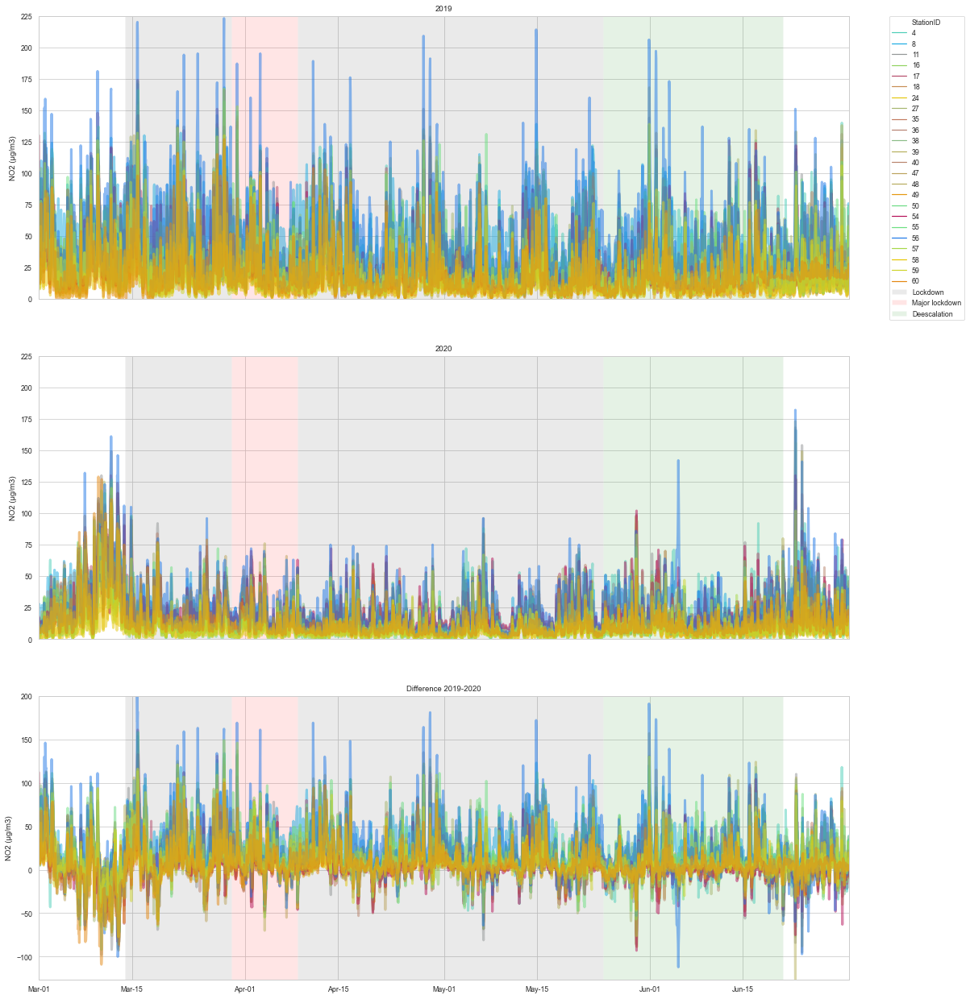

In [40]:
f, ax = plt.subplots(figsize=(18,22), nrows = 3)
##
# 2019
sns.lineplot(x = "Date", y = "NO2_y", data = data_diff, 
             hue = "StationID", alpha = 0.5, ax = ax[0],palette = palette_stations, label='_nolegend_', 
             linewidth = 3)
ax[0].tick_params(axis='x', which='both', bottom=False, labelbottom=False)
ax[0].set_xlabel("")
ax[0].set_ylabel("NO2 (µg/m3)")
ax[0].set_title("2019")
ax[0].autoscale(enable=True, axis='both', tight=True)
ax[0].set_ylim([0,225])
# Primer estado de alarma
ax[0].axvspan(dt.datetime(year=2020,month=3,day=14),dt.datetime(year=2020,month=3,day=30), 
              facecolor='0.2', alpha=0.1, label = "Lockdown")
# Todo no esencial cerrado
ax[0].axvspan(dt.datetime(year=2020,month=3,day=30),dt.datetime(year=2020,month=4,day=9), 
              facecolor='red', alpha=0.1, label = "Major lockdown")
# Segundo estado de alarma
ax[0].axvspan(dt.datetime(year=2020,month=4,day=9),dt.datetime(year=2020,month=5,day=25), 
              facecolor='0.2', alpha=0.1, label = "_nolegend_")
#Desescalada
ax[0].axvspan(dt.datetime(year=2020,month=5,day=25),dt.datetime(year=2020,month=6,day=21), 
              facecolor='green', alpha=0.1, label = "Deescalation")
ax[0].legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

##
# 2020
sns.lineplot(x = "Date", y = "NO2_x", data = data_diff, 
             hue = "StationID", alpha = 0.5, ax = ax[1],palette = palette_stations, label='_nolegend_', 
             linewidth = 3)
ax[1].tick_params(axis='x', which='both', bottom=False, labelbottom=False)
ax[1].set_title("2020")
ax[1].set_xlabel("")
ax[1].set_ylabel("NO2 (µg/m3)")
ax[1].autoscale(enable=True, axis='both', tight=True)
# Primer estado de alarma
ax[1].axvspan(dt.datetime(year=2020,month=3,day=14),dt.datetime(year=2020,month=3,day=30), 
              facecolor='0.2', alpha=0.1, label = "Lockdown")
# Todo no esencial cerrado
ax[1].axvspan(dt.datetime(year=2020,month=3,day=30),dt.datetime(year=2020,month=4,day=9), 
              facecolor='red', alpha=0.1, label = "Major lockdown")
# Segundo estado de alarma
ax[1].axvspan(dt.datetime(year=2020,month=4,day=9),dt.datetime(year=2020,month=5,day=25), 
              facecolor='0.2', alpha=0.1, label = "_nolegend_")
#Desescalada
ax[1].axvspan(dt.datetime(year=2020,month=5,day=25),dt.datetime(year=2020,month=6,day=21), 
              facecolor='green', alpha=0.1, label = "Deescalation")
ax[1].get_legend().remove()
ax[1].set_ylim([0,225])


##
# Diff
sns.lineplot(x = "Date", y = "Diff", data = data_diff, 
             hue = "StationID", alpha = 0.5, ax = ax[2],palette = palette_stations, label='_nolegend_', 
             linewidth = 3)
ax[2].set_xlabel("")
ax[2].set_ylabel("NO2 (µg/m3)")
ax[2].set_title("Difference 2019-2020")
date_form = DateFormatter("%b-%d")
ax[2].xaxis.set_major_formatter(date_form)
ax[2].autoscale(enable=True, axis='both', tight=True)
# Primer estado de alarma
ax[2].axvspan(dt.datetime(year=2020,month=3,day=14),dt.datetime(year=2020,month=3,day=30), 
              facecolor='0.2', alpha=0.1, label = "Lockdown")
# Todo no esencial cerrado
ax[2].axvspan(dt.datetime(year=2020,month=3,day=30),dt.datetime(year=2020,month=4,day=9), 
              facecolor='red', alpha=0.1, label = "Major lockdown")
# Segundo estado de alarma
ax[2].axvspan(dt.datetime(year=2020,month=4,day=9),dt.datetime(year=2020,month=5,day=25), 
              facecolor='0.2', alpha=0.1, label = "_nolegend_")
#Desescalada
ax[2].axvspan(dt.datetime(year=2020,month=5,day=25),dt.datetime(year=2020,month=6,day=21), 
              facecolor='green', alpha=0.1, label = "Deescalation")
ax[2].get_legend().remove()

## 3.2. Daily NO2 levels

In [41]:
data_diff_daily = data_diff.groupby(["Month","Day","StationID"]).mean().reset_index()
data_diff_daily["Date"] = "2020-"+data_diff_daily["Month"].astype(str)+"-" \
                        +data_diff_daily["Day"].astype(str)
data_diff_daily["Date"] = pd.to_datetime(data_diff_daily["Date"])

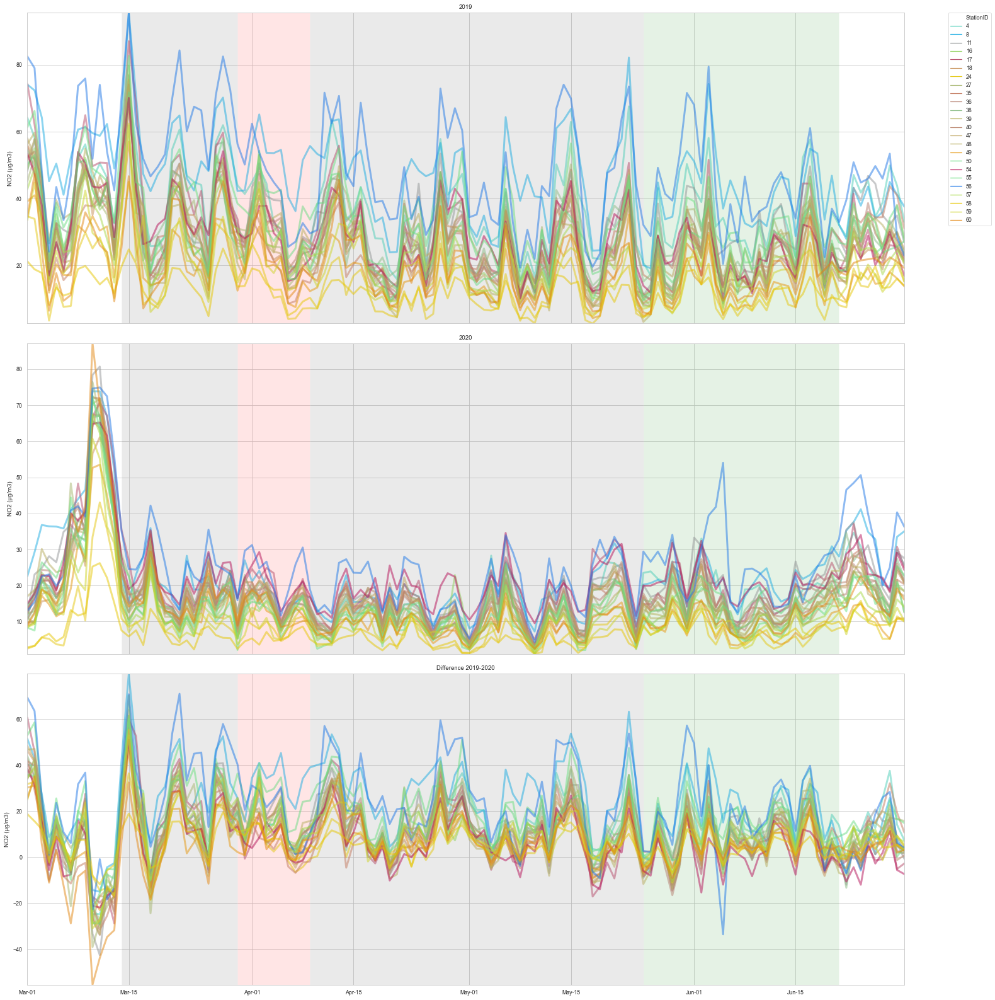

In [42]:
f, ax = plt.subplots(figsize=(20,22), nrows = 3)
plt.tight_layout()

##
# 2019
sns.lineplot(x = "Date", y = "NO2_y", data = data_diff_daily, 
             hue = "StationID", alpha = 0.5, ax = ax[0],palette = palette_stations, label='_nolegend_', 
             linewidth = 3)
ax[0].legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
ax[0].tick_params(axis='x', which='both', bottom=False, labelbottom=False)
ax[0].set_xlabel("")
ax[0].set_ylabel("NO2 (µg/m3)")
ax[0].set_title("2019")
ax[0].autoscale(enable=True, axis='both', tight=True)
# Primer estado de alarma
ax[0].axvspan(dt.datetime(year=2020,month=3,day=14),dt.datetime(year=2020,month=3,day=30), 
              facecolor='0.2', alpha=0.1, label = "Lockdown")
# Todo no esencial cerrado
ax[0].axvspan(dt.datetime(year=2020,month=3,day=30),dt.datetime(year=2020,month=4,day=9), 
              facecolor='red', alpha=0.1, label = "Major lockdown")
# Segundo estado de alarma
ax[0].axvspan(dt.datetime(year=2020,month=4,day=9),dt.datetime(year=2020,month=5,day=25), 
              facecolor='0.2', alpha=0.1, label = "_nolegend_")
#Desescalada
ax[0].axvspan(dt.datetime(year=2020,month=5,day=25),dt.datetime(year=2020,month=6,day=21), 
              facecolor='green', alpha=0.1, label = "Deescalation")

##
# 2020
sns.lineplot(x = "Date", y = "NO2_x", data = data_diff_daily, 
             hue = "StationID", alpha = 0.5, ax = ax[1],palette = palette_stations, label='_nolegend_', 
             linewidth = 3)
ax[1].tick_params(axis='x', which='both', bottom=False, labelbottom=False)
ax[1].set_title("2020")
ax[1].set_xlabel("")
ax[1].set_ylabel("NO2 (µg/m3)")
ax[1].autoscale(enable=True, axis='both', tight=True)
# Primer estado de alarma
ax[1].axvspan(dt.datetime(year=2020,month=3,day=14),dt.datetime(year=2020,month=3,day=30), 
              facecolor='0.2', alpha=0.1, label = "Lockdown")
# Todo no esencial cerrado
ax[1].axvspan(dt.datetime(year=2020,month=3,day=30),dt.datetime(year=2020,month=4,day=9), 
              facecolor='red', alpha=0.1, label = "Major lockdown")
# Segundo estado de alarma
ax[1].axvspan(dt.datetime(year=2020,month=4,day=9),dt.datetime(year=2020,month=5,day=25), 
              facecolor='0.2', alpha=0.1, label = "_nolegend_")
#Desescalada
ax[1].axvspan(dt.datetime(year=2020,month=5,day=25),dt.datetime(year=2020,month=6,day=21), 
              facecolor='green', alpha=0.1, label = "Deescalation")
ax[1].get_legend().remove()


##
# Diff
sns.lineplot(x = "Date", y = "Diff", data = data_diff_daily, 
             hue = "StationID", alpha = 0.5, ax = ax[2],palette = palette_stations, label='_nolegend_', 
             linewidth = 3)
ax[2].set_xlabel("")
ax[2].set_ylabel("NO2 (µg/m3)")
ax[2].set_title("Difference 2019-2020")
date_form = DateFormatter("%b-%d")
ax[2].xaxis.set_major_formatter(date_form)
ax[2].autoscale(enable=True, axis='both', tight=True)
# Primer estado de alarma
ax[2].axvspan(dt.datetime(year=2020,month=3,day=14),dt.datetime(year=2020,month=3,day=30), 
              facecolor='0.2', alpha=0.1, label = "Lockdown")
# Todo no esencial cerrado
ax[2].axvspan(dt.datetime(year=2020,month=3,day=30),dt.datetime(year=2020,month=4,day=9), 
              facecolor='red', alpha=0.1, label = "Major lockdown")
# Segundo estado de alarma
ax[2].axvspan(dt.datetime(year=2020,month=4,day=9),dt.datetime(year=2020,month=5,day=25), 
              facecolor='0.2', alpha=0.1, label = "_nolegend_")
#Desescalada
ax[2].axvspan(dt.datetime(year=2020,month=5,day=25),dt.datetime(year=2020,month=6,day=21), 
              facecolor='green', alpha=0.1, label = "Deescalation")
ax[2].get_legend().remove()

## 3.3. Weekly NO2 levels

In [43]:
# Dates
start = dt.datetime(year=2020,month=3,day=14)
end = dt.datetime(year=2020,month=6,day=21)

In [44]:
heatmap_lockdown = pd.pivot_table(data_cleaned[(data_cleaned["Date"]>=start) & \
                        (data_cleaned["Date"]<=end)], values = "NO2", index = "StationID", 
                         columns = ["Weekday","Hour"])
heatmap_no_lockdown = pd.pivot_table(data_cleaned[(data_cleaned["Date"]<=start) | \
                        (data_cleaned["Date"]>=end)], values = "NO2", index = "StationID", 
                         columns = ["Weekday","Hour"])
heatmap_diff = heatmap_no_lockdown-heatmap_lockdown

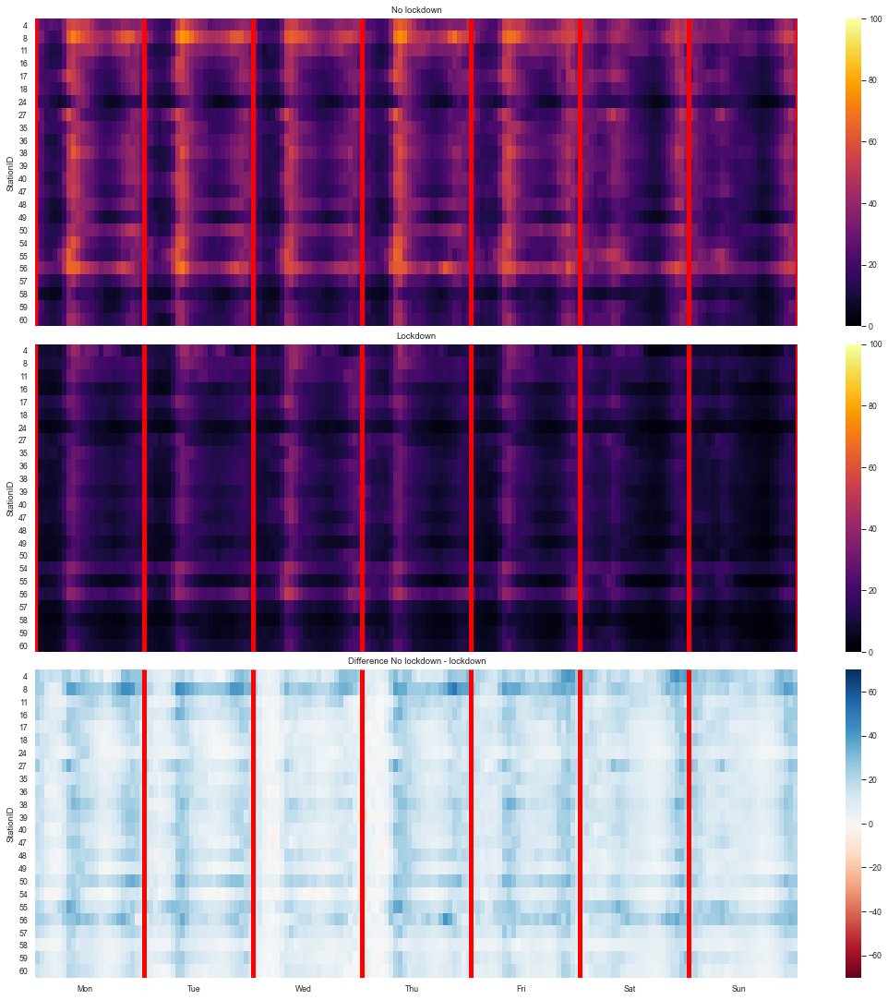

In [45]:
f, ax = plt.subplots(figsize=(15,15), nrows = 3, sharex=True)
plt.tight_layout()
plt.xticks(rotation=45)
# 2019
sns.heatmap(heatmap_no_lockdown, ax = ax[0], vmin=0, vmax=100, cmap='inferno')
ax[0].set_xlabel("")
ax[0].set_title("No lockdown")
ax[0].vlines(range(0,27*7,24), *ax[0].get_ylim(), colors = "red", lw = 5)
ax[0].set_yticklabels(heatmap_lockdown.index, rotation = 0)

# 2020
sns.heatmap(heatmap_lockdown, ax = ax[1], vmin=0, vmax=100, cmap='inferno')
ax[1].set_xlabel("")
ax[1].set_title("Lockdown")
ax[1].vlines(range(0,27*7,24), *ax[1].get_ylim(), colors = "red", lw = 5)
ax[1].set_yticklabels(heatmap_lockdown.index, rotation = 0)

# Diff
sns.heatmap(heatmap_diff, ax = ax[2], vmin=-70, vmax=70, cmap='RdBu')
ax[2].locator_params(axis="x", nbins=7)
ax[2].set_title("Difference No lockdown - lockdown")
ax[2].set_xticks(range(11,24*7-11,24))
ax[2].set_xticklabels(["Mon","Tue","Wed","Thu","Fri","Sat","Sun"])
ax[2].set_xlabel("")
plt.xticks(rotation=0)
ax[2].vlines(range(24,24*7,24), *ax[2].get_ylim(), colors = "red", lw = 5)
ax[2].set_yticklabels(heatmap_lockdown.index, rotation = 0);

Temporal patterns observed during peak hours. Lower values during the weekends. 

# 4. Building the model

In [46]:
data_cleaned["logNO2"] = np.log(data_cleaned["NO2"])
data_cleaned["sqrtNO2"] = np.sqrt(data_cleaned["NO2"])

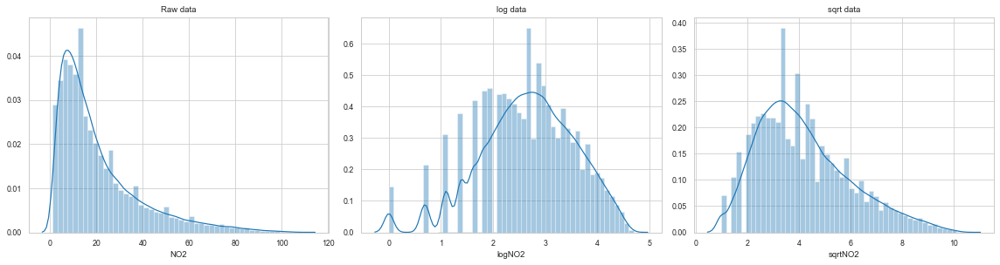

In [47]:
f, ax = plt.subplots(ncols = 3, figsize = (16,4))
plt.tight_layout()
sns.distplot(data_cleaned["NO2"], ax = ax[0])
sns.distplot(data_cleaned["logNO2"], ax = ax[1])
sns.distplot(data_cleaned["sqrtNO2"], ax = ax[2])
ax[0].set_title("Raw data")
ax[1].set_title("log data")
ax[2].set_title("sqrt data");

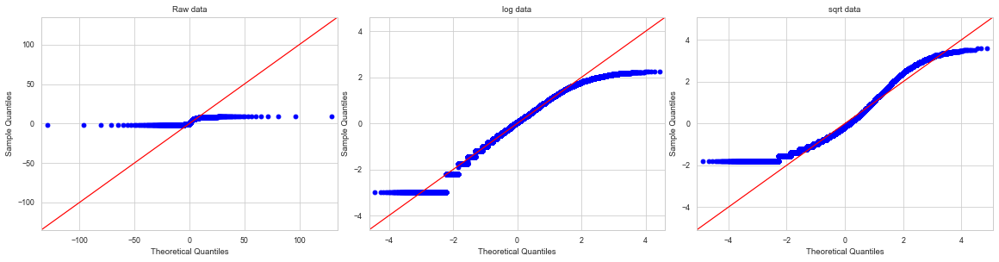

In [48]:
f, ax = plt.subplots(ncols = 3, figsize = (16,4))
plt.tight_layout()
sm.qqplot(data_cleaned["NO2"], stats.t, fit=True, line="45", ax = ax[0])
sm.qqplot(data_cleaned["logNO2"], stats.t, fit=True, line="45", ax = ax[1])
sm.qqplot(data_cleaned["sqrtNO2"], stats.t, fit=True, line="45", ax = ax[2])
ax[0].set_title("Raw data")
ax[1].set_title("log data")
ax[2].set_title("sqrt data");

log(NO2) is a better distribution for modeling.

## 4.1. Weather data

### 4.1.1. Wind

In [49]:
data_cleaned["WindFrac"] = 1/data_cleaned["Wind"]
data_cleaned["WindLog"] = np.log(data_cleaned["Wind"])

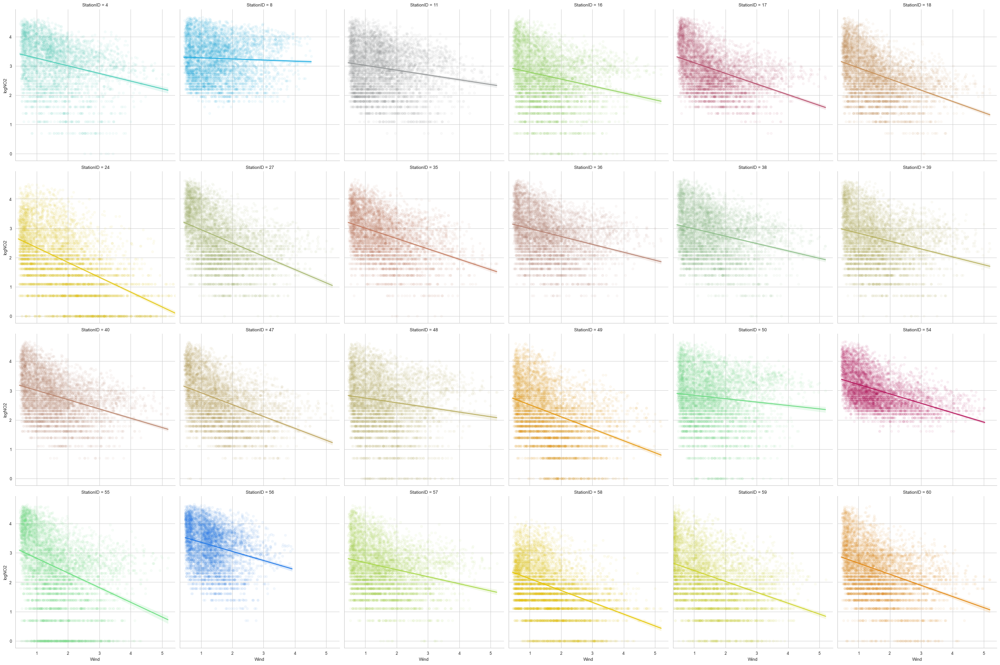

In [50]:
sns.lmplot("Wind", "logNO2", col = "StationID", hue = "StationID", col_wrap=6, data = data_cleaned, 
           scatter_kws={'alpha':0.05}, palette = palette_stations)

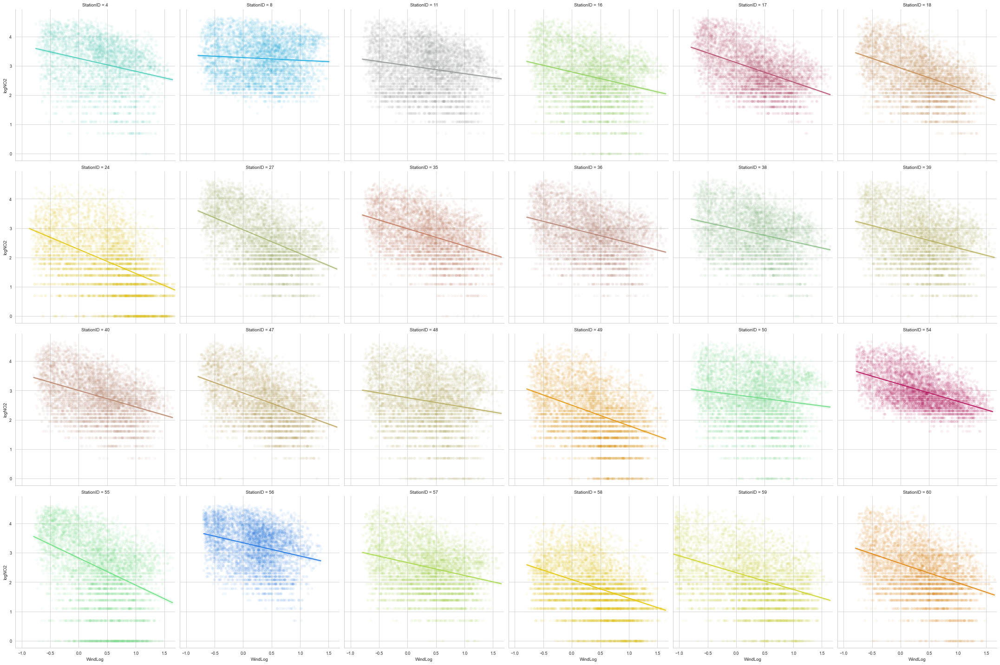

In [51]:
sns_plot = sns.lmplot("WindLog", "logNO2", col = "StationID", hue = "StationID", col_wrap=6, data = data_cleaned, 
           scatter_kws={'alpha':0.05}, palette = palette_stations)

Logarithmic Wind fits better the data.

In [52]:
data_cleaned["WindSplit"], binswind = pd.qcut(data_cleaned["Wind"], 10, retbins = True);

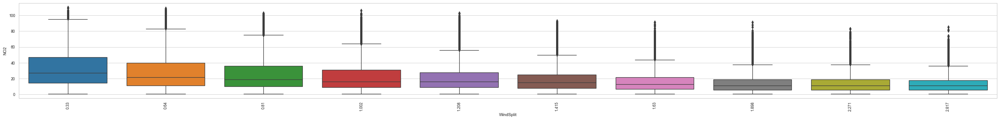

In [53]:
f, ax = plt.subplots(figsize = (40,4))
sns.boxplot(y = data_cleaned["NO2"], x = data_cleaned["WindSplit"], ax = ax)
ax.set_xticklabels(np.round(binswind,3), rotation = 90);

Higher values of wind imply lower levels of NO2. 

### 4.1.2. Temperature

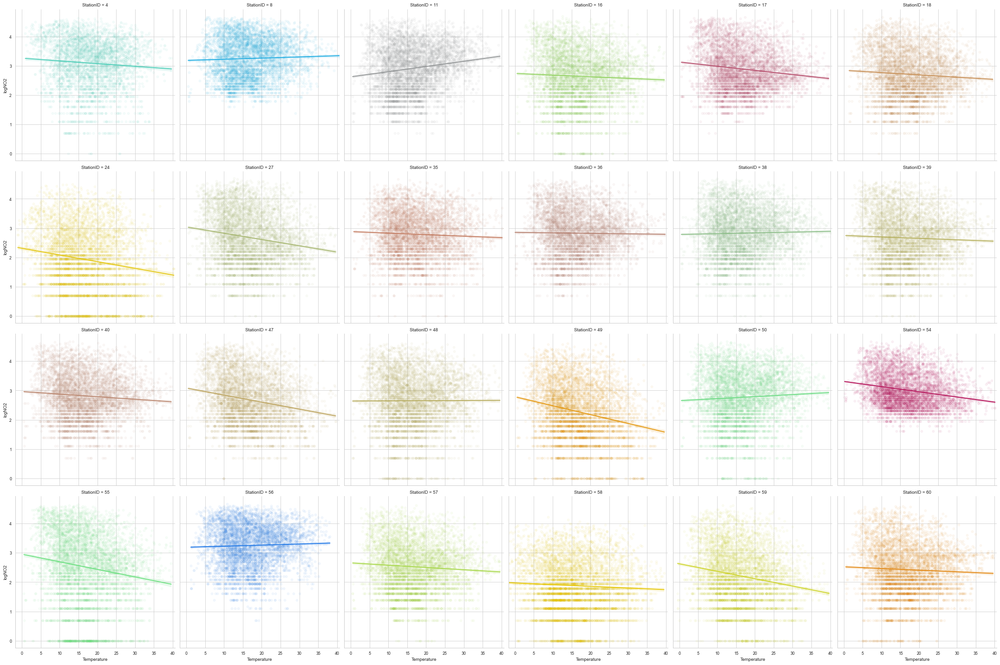

In [54]:
sns.lmplot("Temperature", "logNO2", col = "StationID", hue = "StationID", col_wrap=6, data = data_cleaned, 
           scatter_kws={'alpha':0.05}, palette = palette_stations)

In [55]:
data_cleaned["TempSplit"], binstemp = pd.qcut(data_cleaned["Temperature"], 10, retbins = True)

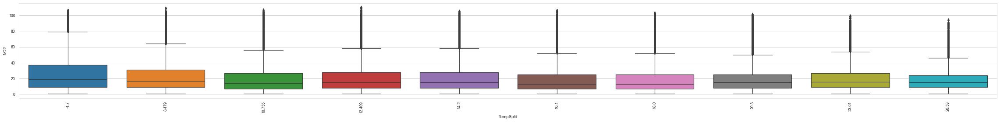

In [56]:
f, ax = plt.subplots(figsize = (40,4))
sns.boxplot(y = data_cleaned["NO2"], x = data_cleaned["TempSplit"], ax = ax)
ax.set_xticklabels(np.round(binstemp,3), rotation = 90);

On average, NO2 levels decrease with higher temperatures. 

### 4.1.3. Humidity

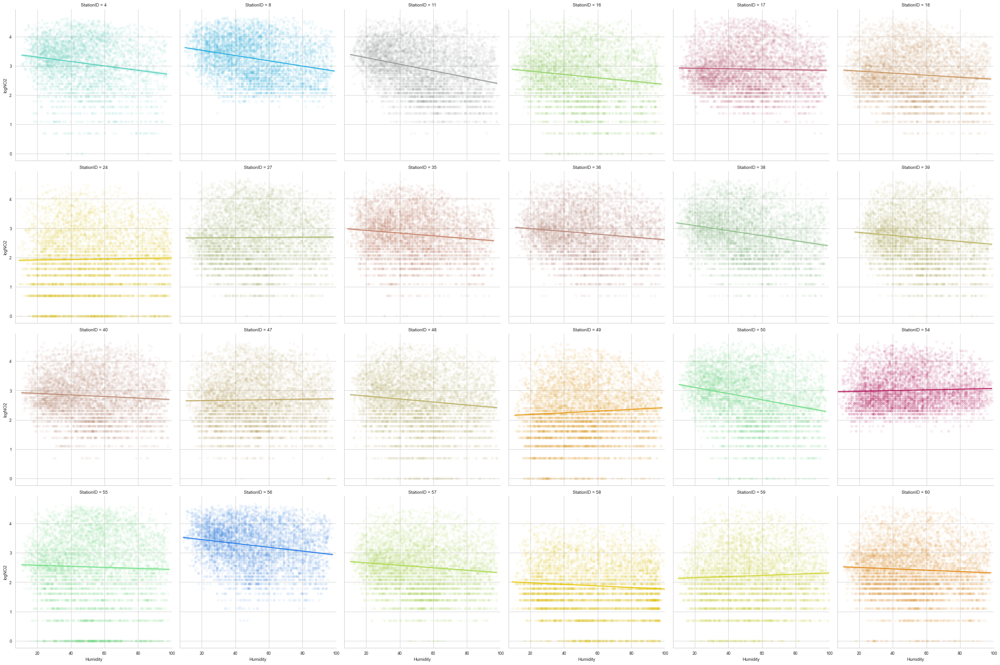

In [57]:
sns.lmplot("Humidity", "logNO2", col = "StationID", hue = "StationID", col_wrap=6, data = data_cleaned, 
           scatter_kws={'alpha':0.05}, palette = palette_stations)

In [58]:
data_cleaned["HumSplit"], binshum = pd.qcut(data_cleaned["Humidity"], 10, retbins = True)

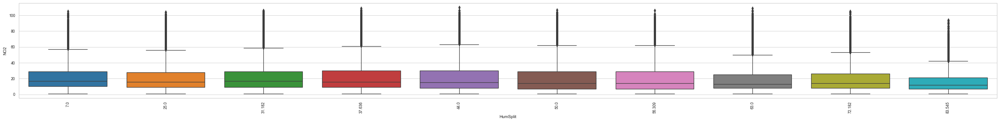

In [59]:
f, ax = plt.subplots(figsize = (40,4))
sns.boxplot(y = data_cleaned["NO2"], x = data_cleaned["HumSplit"], ax = ax)
ax.set_xticklabels(np.round(binshum,3), rotation = 90);

On average, higher humidity means lower values of NO2 levels. 

### 4.1.4. Pressure. 

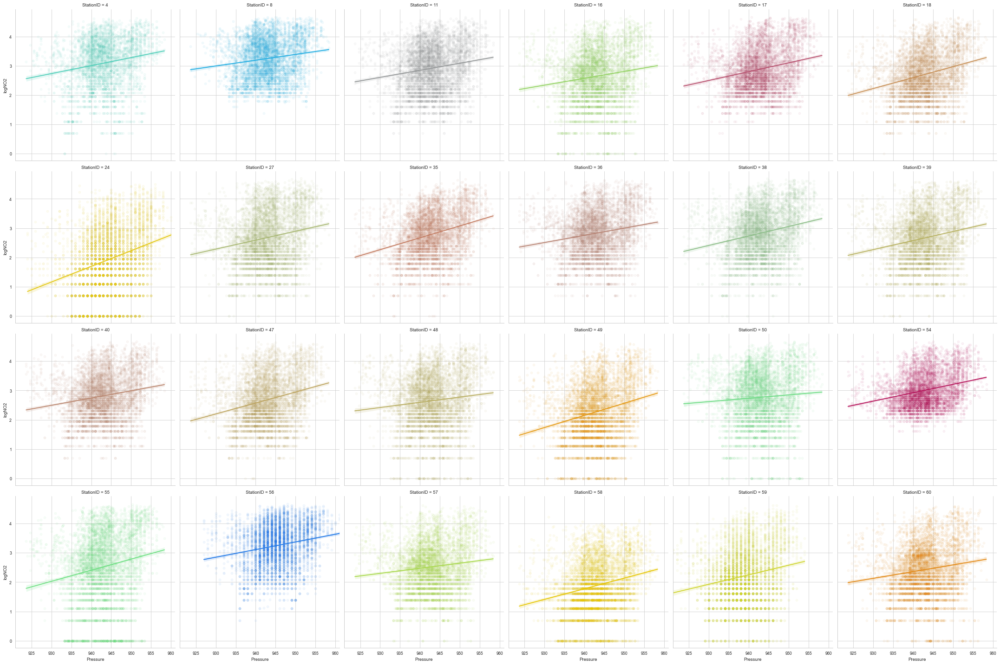

In [60]:
sns.lmplot("Pressure", "logNO2", col = "StationID", hue = "StationID", col_wrap=6, data = data_cleaned, 
           scatter_kws={'alpha':0.05}, palette = palette_stations)

In [61]:
data_cleaned["PresSplit"], binspres = pd.qcut(data_cleaned["Pressure"], 10, retbins = True)

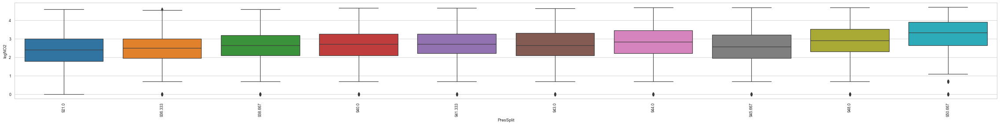

In [62]:
f, ax = plt.subplots(figsize = (40,4))
sns.boxplot(y = data_cleaned["logNO2"], x = data_cleaned["PresSplit"], ax = ax)
ax.set_xticklabels(np.round(binspres,3), rotation = 90);

Higher pressure means higher values of NO2 levels. 

### 4.1.5. Solar radiation

In [63]:
data_cleaned["SolarLog"] = np.log(data_cleaned["Solar"])

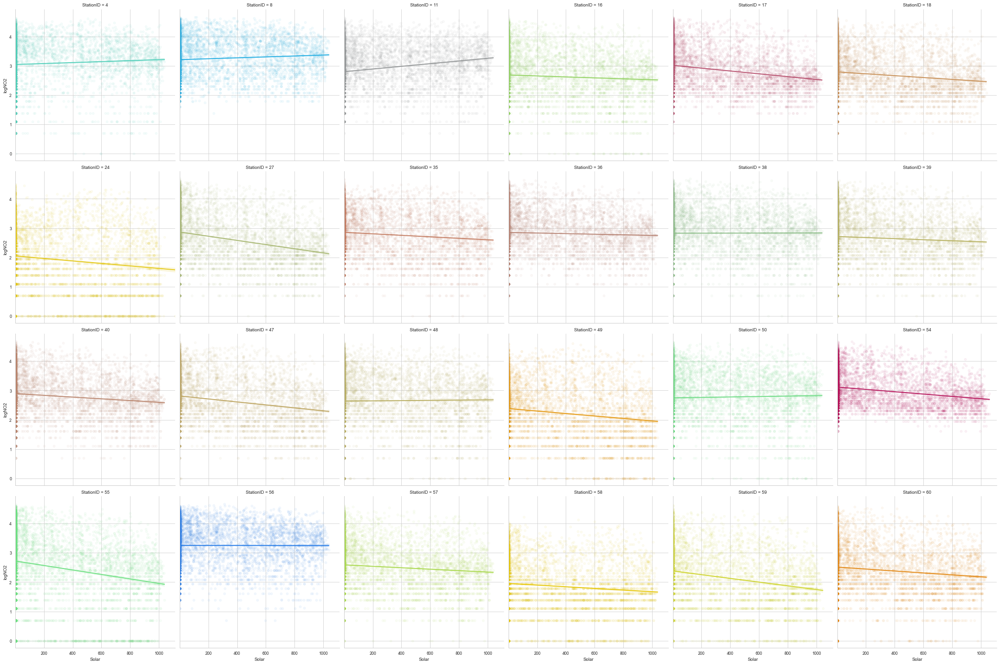

In [64]:
sns.lmplot("Solar", "logNO2", col = "StationID", hue = "StationID", col_wrap=6, data = data_cleaned, 
           scatter_kws={'alpha':0.05}, palette = palette_stations, order = 1)

In [65]:
data_cleaned["SolarSplit"], binssol = pd.qcut(data_cleaned["Solar"], 10, retbins = True, duplicates = "drop")

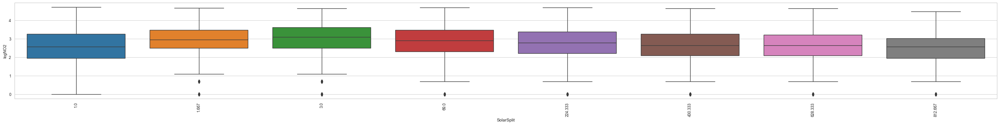

In [66]:
f, ax = plt.subplots(figsize = (40,4))
sns.boxplot(y = data_cleaned["logNO2"], x = data_cleaned["SolarSplit"], ax = ax)
ax.set_xticklabels(np.round(binssol,3), rotation = 90);

A curve is observed for solar values. 

### 4.1.6. Precipitation

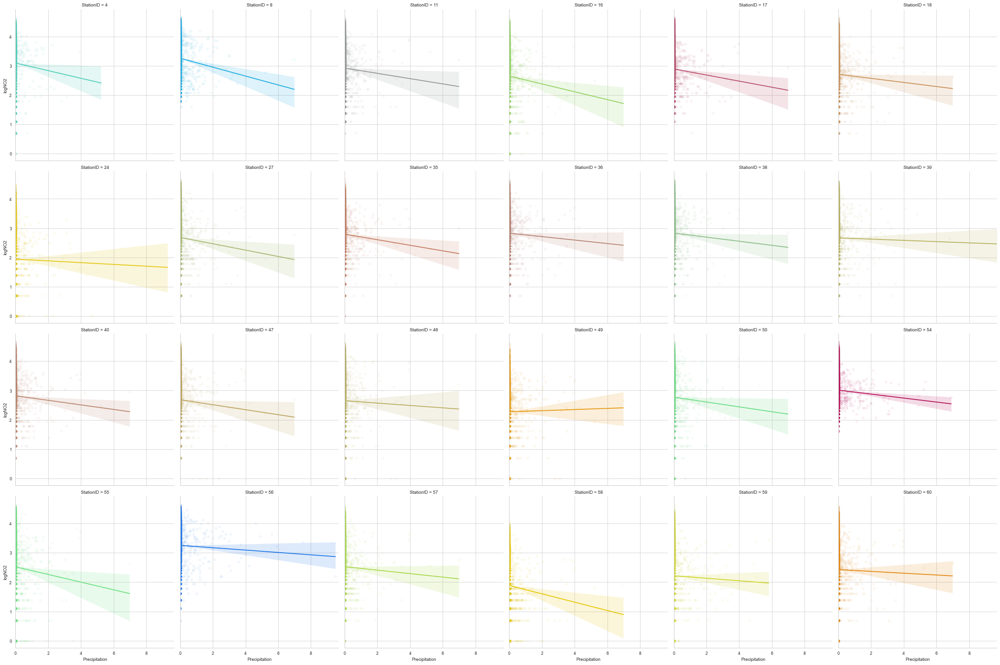

In [67]:
sns.lmplot("Precipitation", "logNO2", col = "StationID", hue = "StationID", col_wrap=6, data = data_cleaned, 
           scatter_kws={'alpha':0.05}, palette = palette_stations)

Most values are null. 

### 4.1.7. Correlation between weather variables

In [68]:
corr_data = data_cleaned[['Wind','Temperature','Humidity','Pressure','Solar','Precipitation','StationID','NO2']]

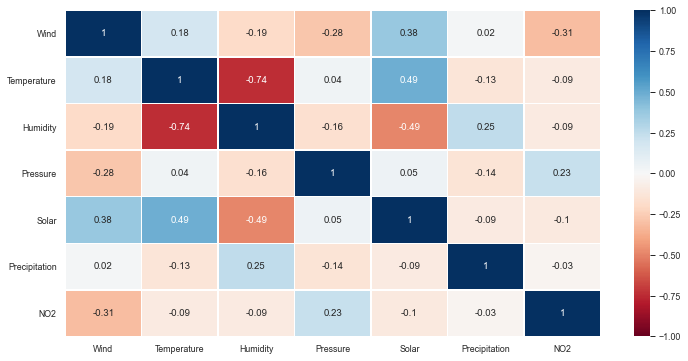

In [69]:
f, ax = plt.subplots(figsize = (12,6))
sns.heatmap(corr_data.drop('StationID', axis = 1).corr().round(2), annot = True, vmin = -1, vmax = 1, 
            cmap = "RdBu", ax = ax, linewidths=.5)

In [70]:
corr_sta = []
for station in corr_data["StationID"].unique():
    station_data = corr_data[(corr_data["StationID"]==station)]
    station_data = station_data[['Wind','Temperature','Humidity','Pressure','Solar','Precipitation','StationID','NO2']]
    corr_station = station_data.corr().iloc[-1,:-2].to_list()
    corr_station.append(station)
    corr_sta.append(corr_station)

In [71]:
corr_sta = pd.DataFrame(corr_sta, columns = ['Wind','Temperature','Humidity','Pressure','Solar','Precipitation','StationID'])

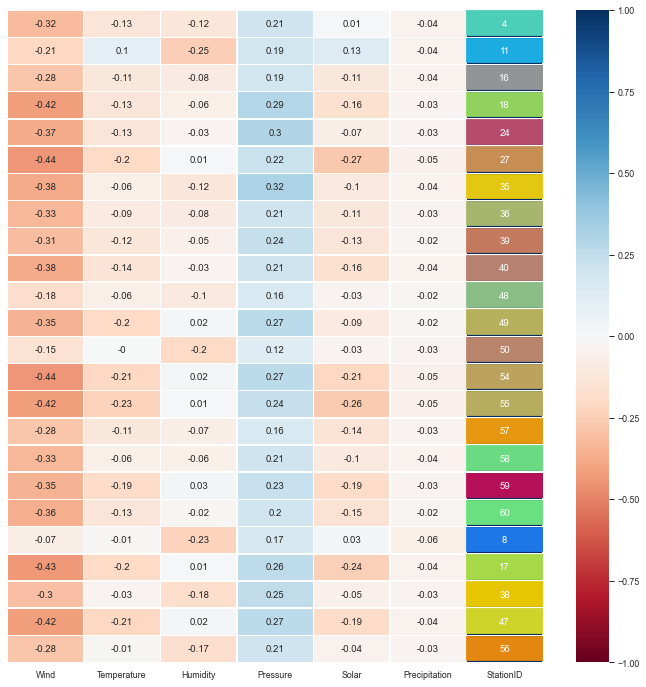

In [72]:
f, ax = plt.subplots(figsize = (12,12))
sns.heatmap(corr_sta.round(2), vmin = -1, vmax = 1, cmap = "RdBu", annot = True, ax = ax, linewidths=.5)
ax.set_yticks([])
for i in range(len(palette_stations)):
    ax.add_patch(
         Rectangle(
            (6, i+0.01),
            1.1,
            0.9,
            fill=True ,
            color = palette_stations[i]
         ) ) 

Depending on the station all variables have a relatively significant correlation, except for precipitation, which is low correlated for all stations. 

## 4.2. Temporal variables

### 4.2.1. Month

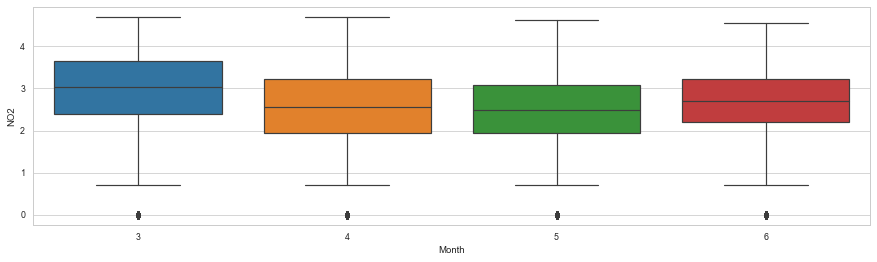

In [73]:
f, ax = plt.subplots(figsize = (15,4))
sns.boxplot(y = np.log(data_cleaned["NO2"]), x = data_cleaned["Month"], ax = ax)

### 4.2.2. Weekday

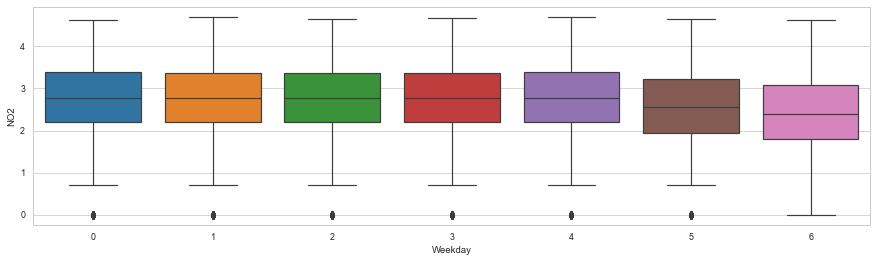

In [74]:
f, ax = plt.subplots(figsize = (15,4))
sns.boxplot(y = np.log(data_cleaned["NO2"]), x = data_cleaned["Weekday"], ax = ax)

In [75]:
data_cleaned["Weekend"] = data_cleaned["Weekday"] < 5

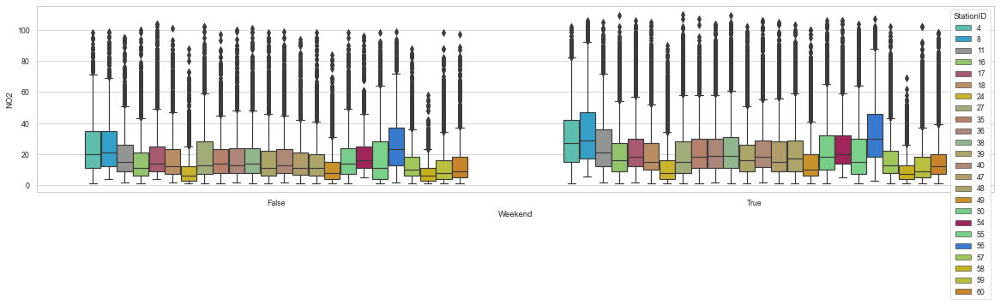

In [76]:
f, ax = plt.subplots(figsize = (20,4))
sns.boxplot(y = data_cleaned["NO2"], x = data_cleaned["Weekend"], ax = ax,
           hue = data_cleaned["StationID"], palette = palette_stations)

### 4.2.3. Hour

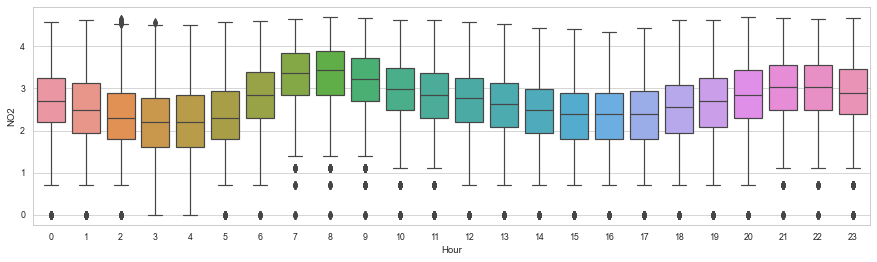

In [77]:
f, ax = plt.subplots(figsize = (15,4))
sns.boxplot(y = np.log(data_cleaned["NO2"]), x = data_cleaned["Hour"], ax = ax)

### 4.2.4. Lockdown

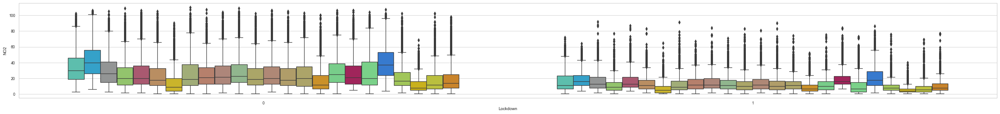

In [78]:
f, ax = plt.subplots(figsize = (40,4))
sns.boxplot(y = data_cleaned["NO2"], x = data_cleaned["Lockdown"], ax = ax,
           hue = data_cleaned["StationID"], palette = palette_stations)
ax.get_legend().remove()

# 5. Modeling hourly values

In [79]:
def aggregation(x):
    return np.mean(x)

In [80]:
def get_regions(train):
    month_station = pd.pivot_table(train, values = "Residuals", index = "Month", 
                         columns = ["StationID"], aggfunc=aggregation)
    weekday_station = pd.pivot_table(train, values = "Residuals", index = "Weekday", 
                         columns = ["StationID"], aggfunc=aggregation)
    hour_station = pd.pivot_table(train, values = "Residuals", index = "Hour", 
                         columns = ["StationID"], aggfunc=aggregation)
    wind_station = pd.pivot_table(train, values = "Residuals", index = "WindSplit", 
                         columns = ["StationID"], aggfunc=aggregation)
    month_weekday = pd.pivot_table(train, values = "Residuals", index = "Weekday", 
                         columns = ["Month"], aggfunc=aggregation)
    month_hour = pd.pivot_table(train, values = "Residuals", index = "Hour", 
                         columns = ["Month"], aggfunc=aggregation)
    month_wind = pd.pivot_table(train, values = "Residuals", index = "WindSplit", 
                         columns = ["Month"], aggfunc=aggregation)
    hour_weekday = pd.pivot_table(train, values = "Residuals", index = "Hour", 
                         columns = ["Weekday"], aggfunc=aggregation)
    wind_weekday = pd.pivot_table(train, values = "Residuals", index = "WindSplit", 
                         columns = ["Weekday"], aggfunc=aggregation)
    wind_hour = pd.pivot_table(train, values = "Residuals", index = "WindSplit", 
                         columns = ["Hour"], aggfunc=aggregation)
    pressure_station = pd.pivot_table(train, values = "Residuals", index = "PresSplit", 
                         columns = ["StationID"], aggfunc=aggregation)
    pressure_month = pd.pivot_table(train, values = "Residuals", index = "PresSplit", 
                         columns = ["Month"], aggfunc=aggregation)
    pressure_weekday = pd.pivot_table(train, values = "Residuals", index = "PresSplit", 
                         columns = ["Weekday"], aggfunc=aggregation)   
    pressure_hour = pd.pivot_table(train, values = "Residuals", index = "PresSplit", 
                         columns = ["Hour"], aggfunc=aggregation)
    pressure_wind = pd.pivot_table(train, values = "Residuals", index = "PresSplit", 
                         columns = ["WindSplit"], aggfunc=aggregation)
    
    f, ax = plt.subplots(nrows = 5, ncols = 5, figsize = (16,12))
    sns.heatmap(month_station, ax = ax[0,0], vmin = -15, vmax = 15, cbar = False, cmap = "RdBu")
    ax[0,0].set_xlabel("")
    ax[0,0].set_xticks([])

    sns.heatmap(weekday_station, ax = ax[1,0], vmin = -15, vmax = 15, cbar = False, cmap = "RdBu")
    ax[1,0].set_xlabel("")
    ax[1,0].set_xticks([])
    
    sns.heatmap(month_weekday, ax = ax[1,1], vmin = -15, vmax = 15, cbar = False, cmap = "RdBu")
    ax[1,1].set_xlabel("")
    ax[1,1].set_xticks([])
    ax[1,1].set_ylabel("")
    ax[1,1].set_yticks([])

    sns.heatmap(hour_station, ax = ax[2,0], vmin = -15, vmax = 15, cbar = False, cmap = "RdBu")
    ax[2,0].set_xlabel("")
    ax[2,0].set_xticks([])

    sns.heatmap(month_hour, ax = ax[2,1], vmin = -15, vmax = 15, cbar = False, cmap = "RdBu")
    ax[2,1].set_xlabel("")
    ax[2,1].set_xticks([])
    ax[2,1].set_ylabel("")
    ax[2,1].set_yticks([])

    sns.heatmap(hour_weekday, ax = ax[2,2], vmin = -15, vmax = 15, cbar = False, cmap = "RdBu")
    ax[2,2].set_xlabel("")
    ax[2,2].set_xticks([])
    ax[2,2].set_ylabel("")
    ax[2,2].set_yticks([])
    
    sns.heatmap(wind_station, ax = ax[3,0], vmin = -15, vmax = 15, cbar = False, cmap = "RdBu")
    ax[3,0].set_xlabel("")
    ax[3,0].set_xticks([])

    sns.heatmap(month_wind, ax = ax[3,1], vmin = -15, vmax = 15, cbar = False, cmap = "RdBu")
    ax[3,1].set_xlabel("")
    ax[3,1].set_xticks([])
    ax[3,1].set_ylabel("")
    ax[3,1].set_yticks([])

    sns.heatmap(wind_weekday, ax = ax[3,2], vmin = -15, vmax = 15, cbar = False, cmap = "RdBu")
    ax[3,2].set_xlabel("")
    ax[3,2].set_xticks([])
    ax[3,2].set_ylabel("")
    ax[3,2].set_yticks([])

    sns.heatmap(wind_hour, ax = ax[3,3], vmin = -15, vmax = 15, cbar = False, cmap = "RdBu")
    ax[3,3].set_xlabel("")
    ax[3,3].set_xticks([])
    ax[3,3].set_ylabel("")
    ax[3,3].set_yticks([])
    
    sns.heatmap(pressure_station, ax = ax[4,0], vmin = -15, vmax = 15, cbar = False, cmap = "RdBu")
    
    sns.heatmap(pressure_month, ax = ax[4,1], vmin = -15, vmax = 15, cbar = False, cmap = "RdBu")
    ax[4,1].set_ylabel("")
    ax[4,1].set_yticks([])
    
    sns.heatmap(pressure_weekday, ax = ax[4,2], vmin = -15, vmax = 15, cbar = False, cmap = "RdBu")
    ax[4,2].set_ylabel("")
    ax[4,2].set_yticks([])

    sns.heatmap(pressure_hour, ax = ax[4,3], vmin = -15, vmax = 15, cbar = False, cmap = "RdBu")
    ax[4,3].set_ylabel("")
    ax[4,3].set_yticks([])
    
    sns.heatmap(pressure_wind, ax = ax[4,4], vmin = -15, vmax = 15, cbar = False, cmap = "RdBu")
    ax[4,4].set_ylabel("")
    ax[4,4].set_yticks([])
    
    ax[0,1].axis('off'),ax[0,2].axis('off'),ax[0,3].axis('off'),ax[1,2].axis('off'),ax[1,3].axis('off'),ax[2,3].axis('off')
    ax[0,4].axis('off'),ax[1,4].axis('off'),ax[2,4].axis('off'),ax[3,4].axis('off')
    return ax

In [81]:
train = data_cleaned.copy()
train["Residuals"] = np.nan
train["ResidualsLog"] = np.nan

## 5.1. Starting from wind and pressure

Using all variables except for precipitation, which had a low correlation for all stations. 

In [82]:
selected_variables = ['np.log(Wind)','Pressure','Solar','Humidity','Temperature','Lockdown']
str_model_variables = ' + '.join(selected_variables[:])

# Empty dicts
model_dict = {}
r_squared = []
for station in train["StationID"].unique():
    # Filters
    sfilter = train["StationID"]==station
    totalfilter = sfilter
    filtered_data = train[totalfilter]
    reg_mod = smf.ols(formula = 'np.log(NO2) ~ '+str_model_variables, data = filtered_data).fit()
    train.loc[totalfilter, "ResidualsLog"] = reg_mod.resid
    train.loc[totalfilter, "Residuals"] = train.loc[totalfilter, "NO2"] - np.exp(reg_mod.fittedvalues)
    model_dict[station] = reg_mod
    r_squared.append(reg_mod.rsquared)
print("MSE: ", train["Residuals"].abs().mean())
print("Confidence interval: ", np.quantile(train["Residuals"],[0.025,0.975]))
print("R2: ", np.mean(r_squared))
print("R2-q: ", np.quantile(r_squared,[0.025,0.975]))

MSE:  9.566182216820854
Confidence interval:  [-17.05986477  40.24804491]
R2:  0.35850812172910834
R2-q:  [0.22704183 0.45575386]


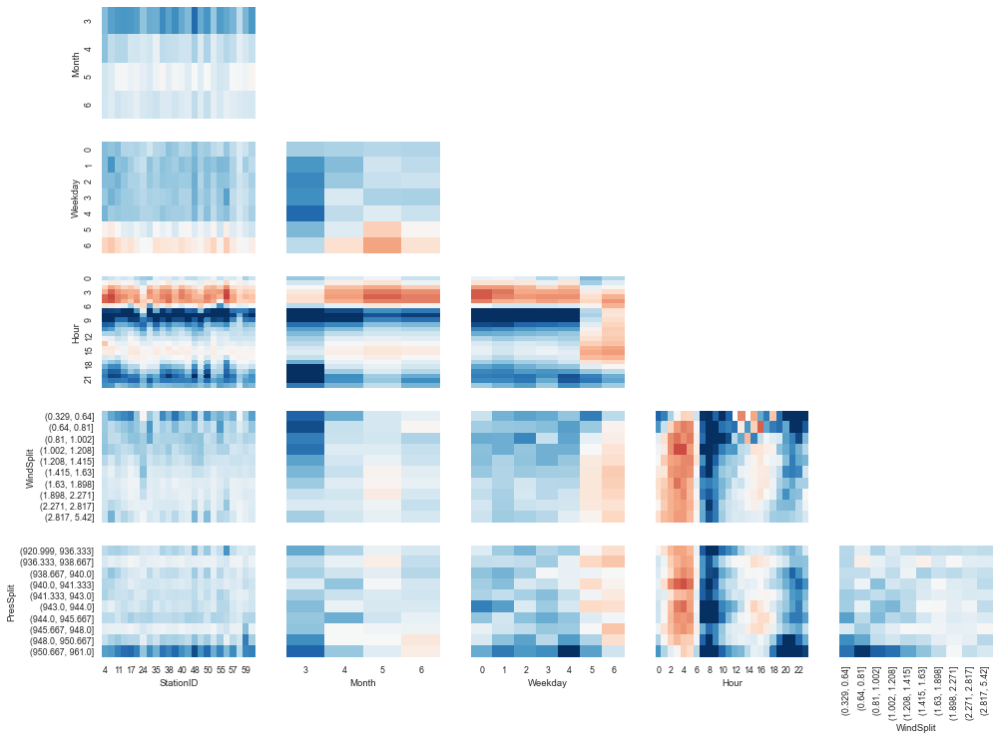

In [83]:
get_regions(train=train);

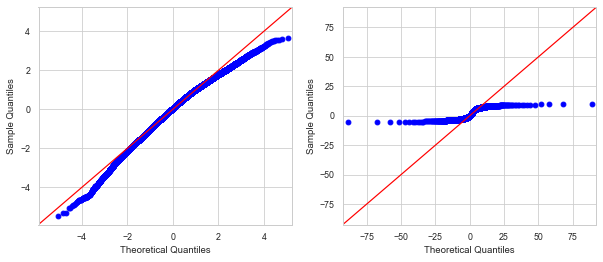

In [84]:
f, ax = plt.subplots(ncols = 2, figsize = (10,4))
sm.qqplot(train["ResidualsLog"], stats.t, fit=True, line="45", ax = ax[0])
sm.qqplot(train["Residuals"], stats.t, fit=True, line="45", ax = ax[1])
plt.show()

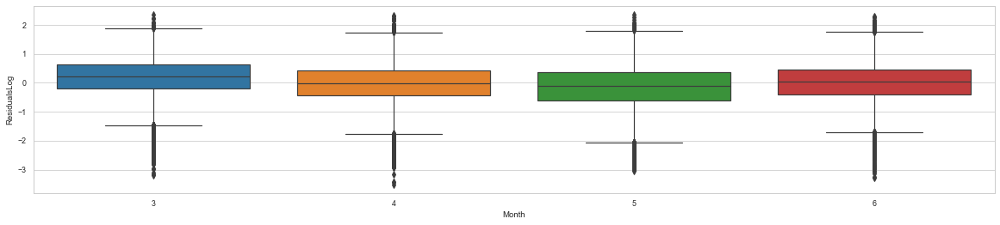

In [85]:
f, ax = plt.subplots(figsize = (20,4))
sns.boxplot(y = train["ResidualsLog"], x = train["Month"], ax = ax)

March is different from the other months. 

## 5.2. Modeling each month separately

In [86]:
selected_variables = ['np.log(Wind)','Pressure','Solar','Humidity','Temperature','Lockdown']
str_model_variables = ' + '.join(selected_variables[:])

# Empty dicts
model_dict = {}
r_squared = []
for station in train["StationID"].unique():
    month_dict = {}
    r_month = []
    
    for month in train["Month"].unique():
        # Filters
        sfilter = train["StationID"]==station
        mfilter = train["Month"]==month
        totalfilter = sfilter & mfilter
        
        # Training
        filtered_data = train[totalfilter]
        reg_mod = smf.ols(formula = 'np.log(NO2) ~ '+str_model_variables, data = filtered_data).fit()
        train.loc[totalfilter, "ResidualsLog"] = reg_mod.resid
        train.loc[totalfilter, "Residuals"] = train.loc[totalfilter, "NO2"] - np.exp(reg_mod.fittedvalues)
        
        # Saving models
        month_dict[month] = reg_mod
        r_month.append(reg_mod.rsquared)
        
    # Saving models
    model_dict[station] = month_dict
    r_squared.append(r_month)
    
print("MSE: ", train["Residuals"].abs().mean())
print("Confidence interval: ", np.quantile(train["Residuals"],[0.025,0.975]))
print("R2: ", np.mean(r_squared))
print("R2-q: ", np.quantile(r_squared,[0.025,0.975]))

MSE:  9.000073323913252
Confidence interval:  [-16.81273854  38.1968122 ]
R2:  0.37819178452047436
R2-q:  [0.19224243 0.54589655]


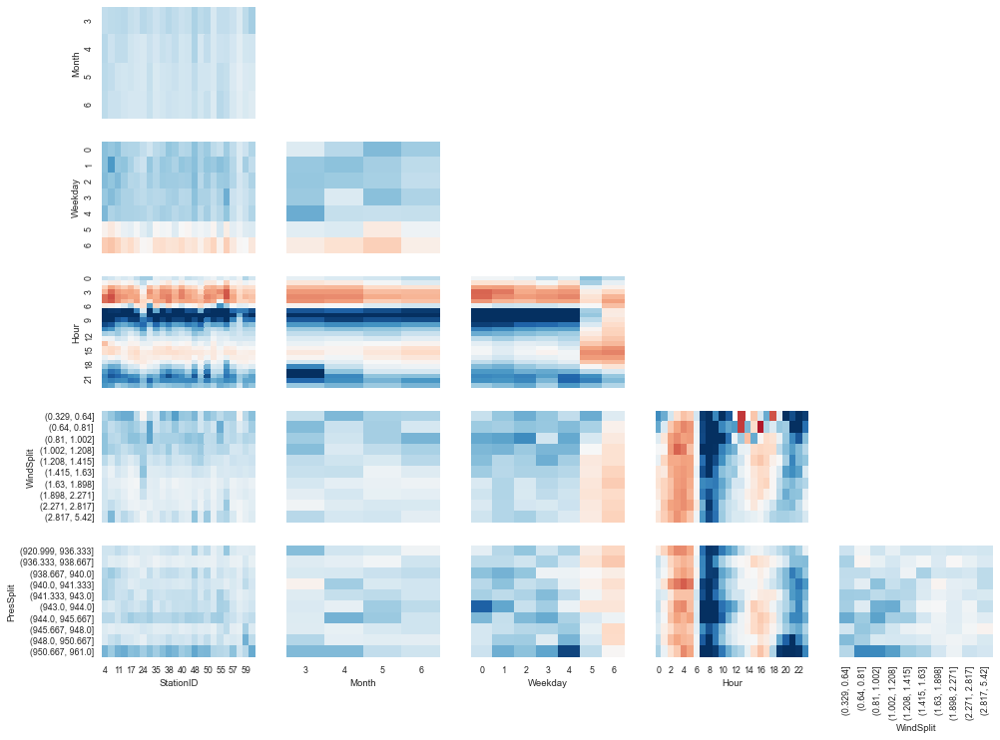

In [87]:
get_regions(train=train);

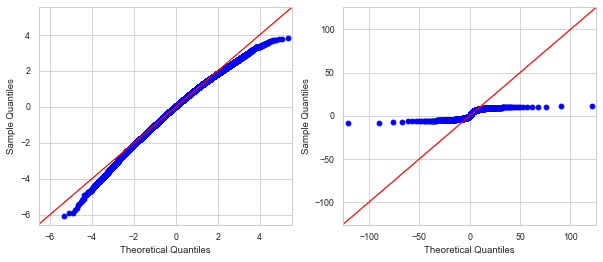

In [88]:
f, ax = plt.subplots(ncols = 2, figsize = (10,4))
sm.qqplot(train["ResidualsLog"], stats.t, fit=True, line="45", ax = ax[0])
sm.qqplot(train["Residuals"], stats.t, fit=True, line="45", ax = ax[1])
plt.show()

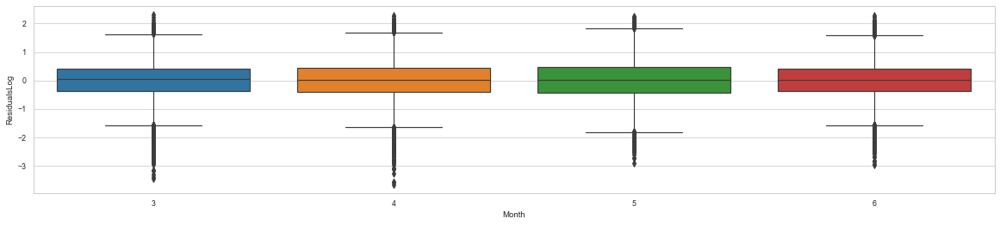

In [89]:
f, ax = plt.subplots(figsize = (20,4))
sns.boxplot(y = train["ResidualsLog"], x = train["Month"], ax = ax)

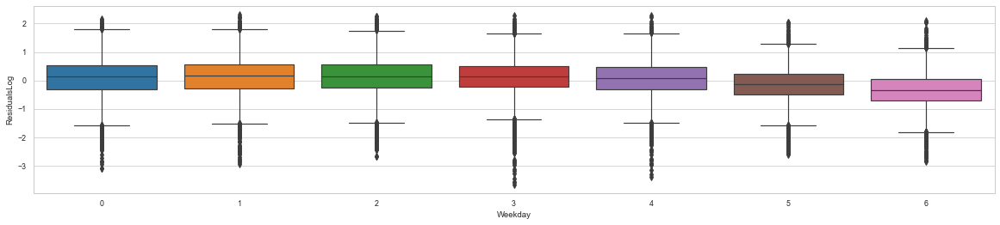

In [90]:
f, ax = plt.subplots(figsize = (20,4))
sns.boxplot(y = train["ResidualsLog"], x = train["Weekday"], ax = ax)

## 5.3. Modeling days of the week

In [91]:
selected_variables = ['np.log(Wind)','Pressure','Solar','Humidity','Temperature','Lockdown']
str_model_variables = ' + '.join(selected_variables[:])

# Empty dicts
model_dict = {}
r_squared = []
for station in train["StationID"].unique():
    month_dict = {}
    r_month = []
    
    for month in train["Month"].unique():
        weekday_dict = {}
        r_weekday = []
        
        for weekday in train["Weekday"].unique():
            # Filters
            sfilter = train["StationID"]==station
            mfilter = train["Month"]==month
            wfilter = train["Weekday"]==weekday
            totalfilter = sfilter & mfilter & wfilter
        
            # Training
            filtered_data = train[totalfilter]
            reg_mod = smf.ols(formula = 'np.log(NO2) ~ '+str_model_variables, data = filtered_data).fit()
            train.loc[totalfilter, "ResidualsLog"] = reg_mod.resid                
            train.loc[totalfilter, "Residuals"] = train.loc[totalfilter, "NO2"] - np.exp(reg_mod.fittedvalues)
                
            # Saving models
            weekday_dict[weekday] = reg_mod
            r_weekday.append(reg_mod.rsquared)
        
        # Saving models
        month_dict[month] = weekday_dict
        r_month.append(r_weekday)
        
    # Saving models
    model_dict[station] = month_dict
    r_squared.append(r_month)
    
print("MSE: ", train["Residuals"].abs().mean())
print("Confidence interval: ", np.quantile(train["Residuals"],[0.025,0.975]))
print("R2: ", np.mean(r_squared))
print("R2-q: ", np.quantile(r_squared,[0.025,0.975]))

MSE:  8.145140284030127
Confidence interval:  [-17.01712333  34.96050598]
R2:  0.46450708144152
R2-q:  [0.21766043 0.74727956]


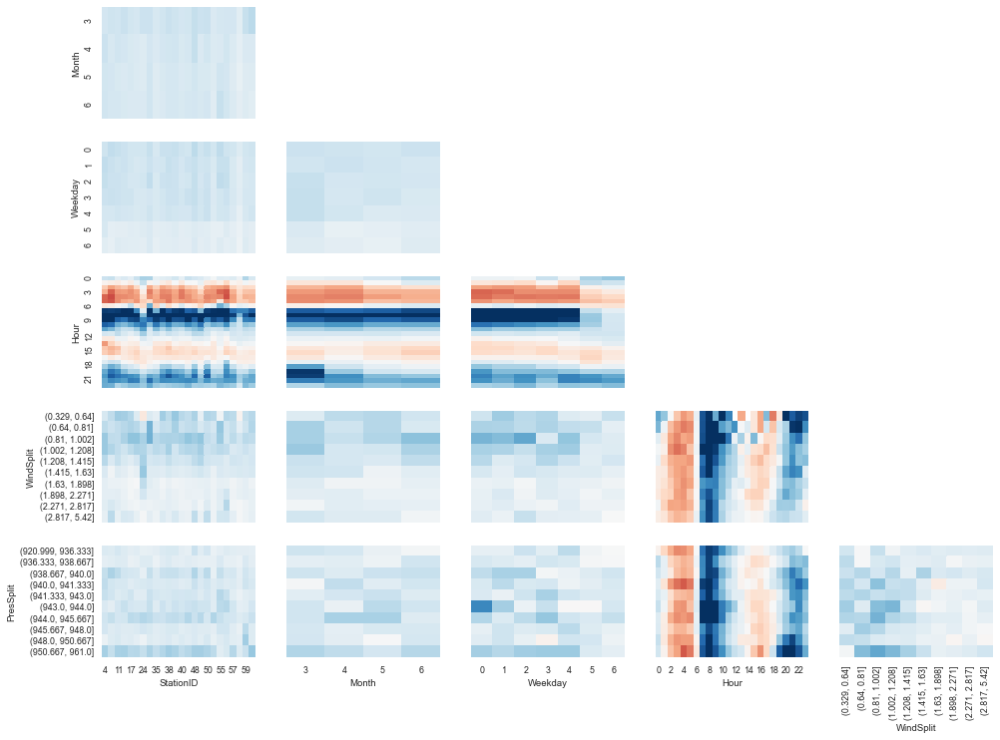

In [92]:
get_regions(train=train);

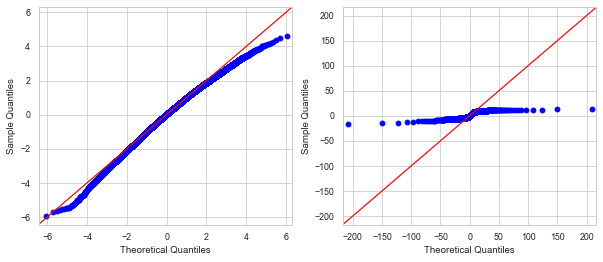

In [93]:
f, ax = plt.subplots(ncols = 2, figsize = (10,4))
sm.qqplot(train["ResidualsLog"], stats.t, fit=True, line="45", ax = ax[0])
sm.qqplot(train["Residuals"], stats.t, fit=True, line="45", ax = ax[1])
plt.show()

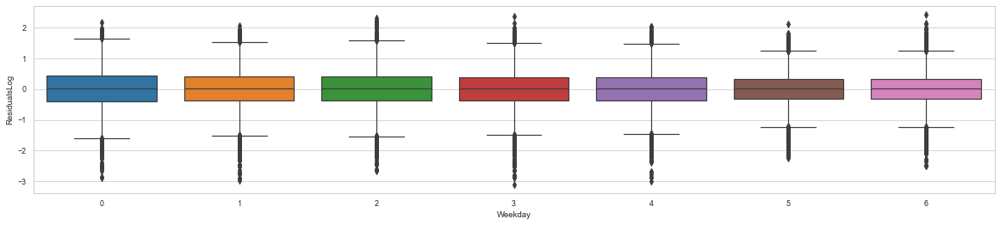

In [94]:
f, ax = plt.subplots(figsize = (20,4))
sns.boxplot(y = train["ResidualsLog"], x = train["Weekday"], ax = ax)

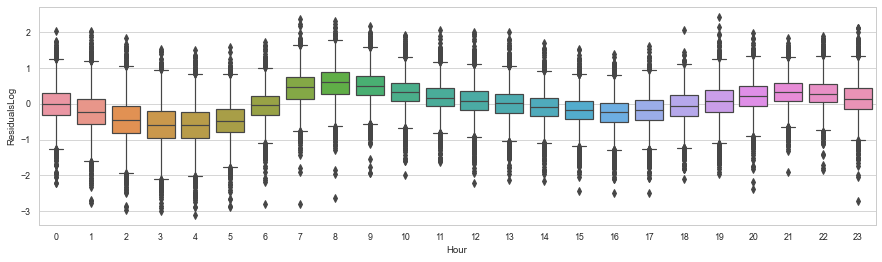

In [95]:
f, ax = plt.subplots(figsize = (15,4))
sns.boxplot(y = train["ResidualsLog"], x = train["Hour"], ax = ax)

### 5.3.1. Fourier transform

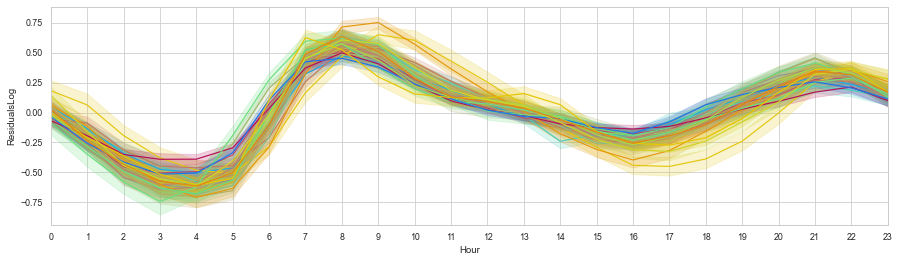

In [96]:
f, ax = plt.subplots(figsize = (15,4))
sns.lineplot(y = train["ResidualsLog"], x = train["Hour"], hue = train["StationID"], 
                        palette = palette_stations, ax = ax)
ax.get_legend().remove()
ax.set_xlim([0,23])
ax.set_xticks(range(0,24))
ax.set_xticklabels(range(0,24));

In [97]:
freq = []
ampli = []
p = []
for station in train["StationID"].unique():
    ## Selecting the data
    data_hour = train.loc[train["StationID"]==station,["Hour","ResidualsLog"]].groupby("Hour").mean().reset_index()
    data_hour = pd.concat([data_hour, data_hour, data_hour, data_hour]).reset_index(drop = True)
    data_hour["Hour"] = data_hour.index
    
    ## Selecting the vectors
    xnew = data_hour["Hour"].to_numpy()
    ynew = data_hour["ResidualsLog"].to_numpy()
    
    ## Interpolation for accuracy
    inter = interp1d(xnew, ynew, kind = "cubic")
    s = 0.01
    xnew = np.arange(min(xnew), max(xnew)+s, s)
    ynew = inter(xnew)
    
    ## Fourier transform
    # Number of sample points
    N = len(xnew)
    # Sample spacing
    T = xnew[1]-xnew[0]
    ynew = ynew-np.mean(ynew)
    yf = fft(ynew)
    yf =  (2.0/N * np.abs(yf[0:N//2])).tolist()
    xf = fftfreq(N, T)[:N//2]
    
    # Greater frequencies index
    index = [i[0] for i in sorted(enumerate(yf), key=lambda x:x[1], reverse = True)]
    index_fil = index[:10]
    
    # Frequencies
    freqs = [2*np.pi*xf[i] for i in index_fil]
    freqs.append(station)
    freq.append(freqs)
    
    # Amplitudes
    amplitudes = [yf[i] for i in index_fil]
    amplitudes.append(station)
    ampli.append(amplitudes)

In [98]:
frequencies = pd.DataFrame(freq).round(3)

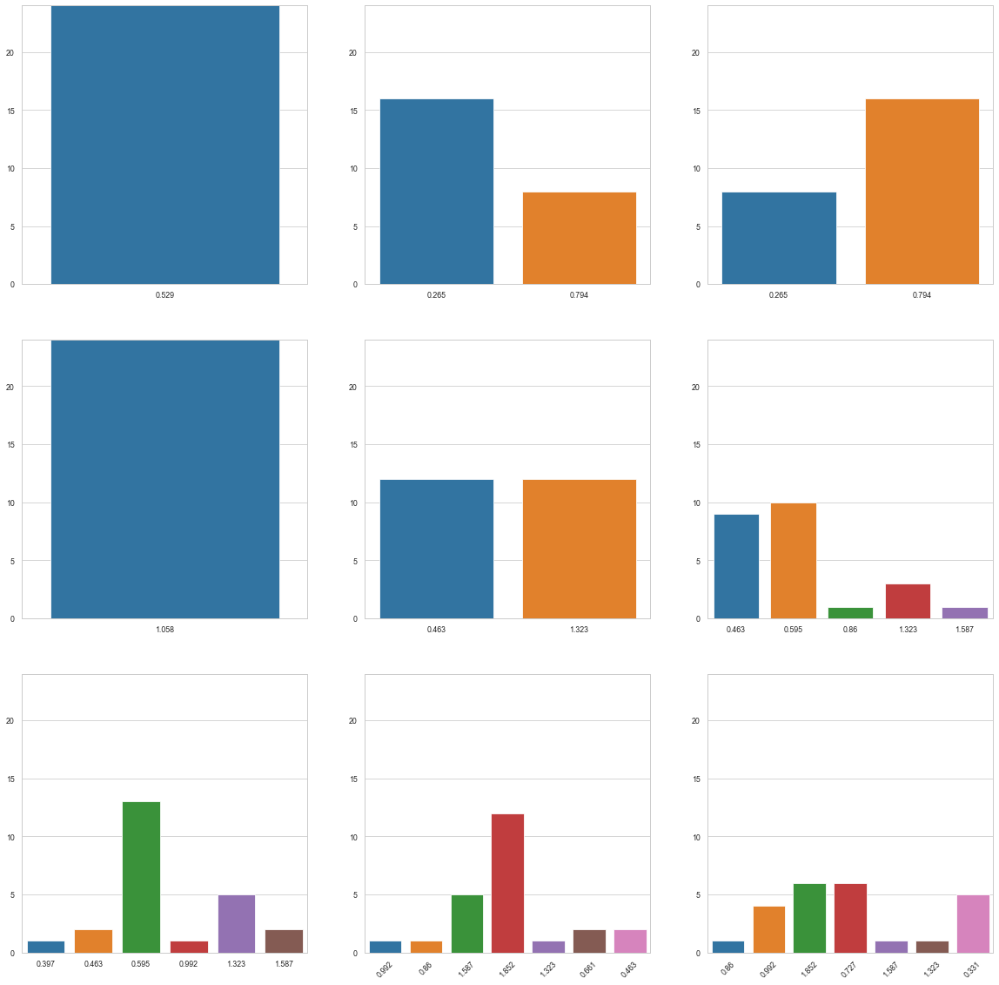

In [99]:
f, ax = plt.subplots(ncols = 3, nrows = 3, figsize = (20,20))
sns.barplot(frequencies[0].value_counts().index, frequencies[0].value_counts().values, ax = ax[0][0])
sns.barplot(frequencies[1].value_counts().index, frequencies[1].value_counts().values, ax = ax[0][1])
sns.barplot(frequencies[2].value_counts().index, frequencies[2].value_counts().values, ax = ax[0][2])
sns.barplot(frequencies[3].value_counts().index, frequencies[3].value_counts().values, ax = ax[1][0])
sns.barplot(frequencies[4].value_counts().index, frequencies[4].value_counts().values, ax = ax[1][1])
sns.barplot(frequencies[5].value_counts().index, frequencies[5].value_counts().values, ax = ax[1][2])
sns.barplot(frequencies[6].value_counts().index, frequencies[6].value_counts().values, ax = ax[2][0])
sns.barplot(frequencies[7].value_counts().index, frequencies[7].value_counts().values, ax = ax[2][1])
sns.barplot(frequencies[8].value_counts().index, frequencies[8].value_counts().values, ax = ax[2][2])
for i in range(3):
    for j in range(3):
        ax[i][j].set_ylim([0,24])
ax[2][2].set_xticklabels(frequencies[8].value_counts().index, rotation = 45)
ax[2][1].set_xticklabels(frequencies[7].value_counts().index, rotation = 45);

In [100]:
dict_freq = {}
for i in range(frequencies.shape[1]-6):
    index = frequencies[i].value_counts().index
    for idx in index: 
        if idx in dict_freq:
            dict_freq[idx] = dict_freq[idx]+frequencies[i].value_counts().loc[idx]
        else:
            dict_freq[idx] = frequencies[i].value_counts().loc[idx]

In [101]:
freq_count = pd.DataFrame.from_dict(dict_freq, orient='index').reset_index().sort_values("index")

(0.0, 24.0)

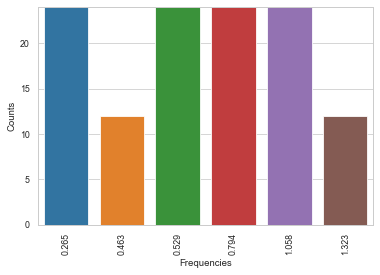

In [102]:
f, ax = plt.subplots()
sns.barplot(freq_count["index"], freq_count[0])
ax.set_xticklabels(round(freq_count["index"],3), rotation = 90);
ax.set_xlabel("Frequencies")
ax.set_ylabel("Counts")
ax.set_ylim([0,24])

Temporal evolution can be explained with these variables. Only frequencies that are present as the top five frequencies for five ore more than five stations will be considered. Three of them are present in all stations (not ordered by importance): 
- 0.265: Which is equivalent to $\frac{\pi}{12}$. Periods of a day.
- 0.463: Which is equivalent to $\frac{5\pi}{34}$. Periods of 13.6 hours. 
- 0.529: Which is equivalent to $\frac{\pi}{6}$. Periods of 12 hours. 
- 0.794: Which is equivalent to $\frac{\pi}{4}$. Periods of 8 hours. 
- 1.058: Which is equivalent to $\frac{\pi}{3}$. Periods of 6 hours.
- 1.323: Which is equivalent to $\frac{5\pi}{12}$. Periods of 4.8 hours.

Phases will be obtained from the average model:

In [103]:
data_hour = train[["Hour","ResidualsLog"]].groupby("Hour").mean().reset_index()
data_hour = pd.concat([data_hour, data_hour, data_hour, data_hour]).reset_index(drop = True)
data_hour["Hour"] = data_hour.index

In [104]:
xnew = data_hour["Hour"].to_numpy()
ynew = data_hour["ResidualsLog"].to_numpy()

In [105]:
inter = interp1d(xnew, ynew, kind = "cubic")
s = 0.0001
xnew = np.arange(min(xnew), max(xnew)+s, s)
ynew = inter(xnew)

(0.0, 2.0)

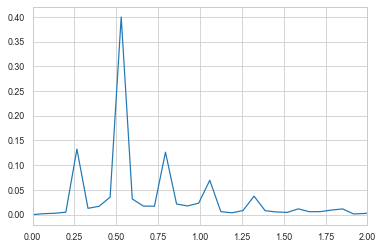

In [106]:
# Number of sample points
N = len(xnew)
# sample spacing
T = xnew[1]-xnew[0]
ynew = ynew-np.mean(ynew)
yf = fft(ynew)
phase = np.angle(yf)
yf =  2.0/N * np.abs(yf[0:N//2])
xf = fftfreq(N, T)[:N//2]
import matplotlib.pyplot as plt
f, ax = plt.subplots()
ax.plot(2*np.pi*xf, yf)
ax.set_xlim([0,2])

In [107]:
w = [2*np.pi*xf[i] for i in range(len(xf)) if yf[i]>0.033]
A = [yf[i] for i in range(len(xf)) if yf[i]>0.033]
phi = [phase[i] for i in range(len(xf)) if yf[i]>0.033]

In [108]:
data = pd.DataFrame([w,A,phi], index = ["Frequency","Amplitud","Phase"]).round(3)
data

,0,1,2,3,4,5
Frequency,0.265,0.463,0.529,0.794,1.058,1.323
Amplitud,0.133,0.035,0.400,0.126,0.069,0.037
Phase,2.893,-2.090,1.207,0.186,-2.189,2.043


In [109]:
t = np.arange(0,23,0.1)
y1 = np.cos(np.pi/12*np.arange(0,23,0.1)+2.89)
y2 = np.cos(5*np.pi/34*np.arange(0,23,0.1)-2.09)
y3 = np.cos(np.pi/6*np.arange(0,23,0.1)+1.21)
y4 = np.cos(np.pi/4*np.arange(0,23,0.1)+0.19)
y5 = np.cos(np.pi/3*np.arange(0,23,0.1)-2.19)
y6 = np.cos(5*np.pi/12*np.arange(0,23,0.1)+2.04)
ytot = A[0]*y1+A[1]*y2+A[2]*y3+A[3]*y4+A[4]*y5+A[5]*y6

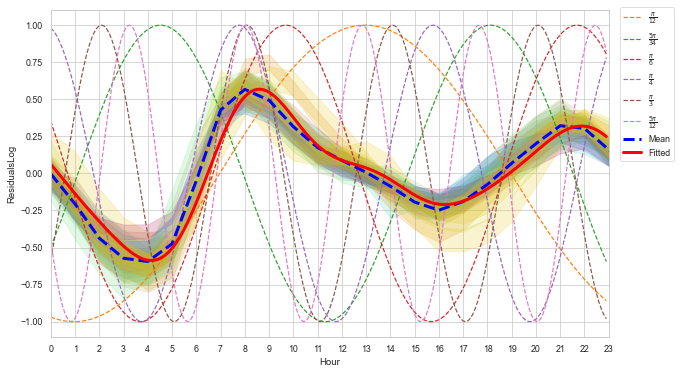

In [110]:
f, ax = plt.subplots(figsize = (10,6))
sns.lineplot(y = train["ResidualsLog"], x = train["Hour"], hue = train["StationID"], palette = palette_stations,
             ax = ax, legend = False, alpha = 0.001)
sns.lineplot(x = t, y = y1, label = r"$\frac{\pi}{12}$")
sns.lineplot(x = t, y = y2, label = r"$\frac{5\pi}{34}$")
sns.lineplot(x = t, y = y3, label = r"$\frac{\pi}{6}$")
sns.lineplot(x = t, y = y4, label = r"$\frac{\pi}{4}$")
sns.lineplot(x = t, y = y5, label = r"$\frac{\pi}{3}$")
sns.lineplot(x = t, y = y6, label = r"$\frac{5\pi}{12}$")
sns.lineplot(x = data_hour["Hour"], y = data_hour["ResidualsLog"]-data_hour["ResidualsLog"].mean(), 
             label = "Mean", linewidth = 3, color='blue')
sns.lineplot(x = t, y = ytot, label = "Fitted", linewidth = 3, color='red')
for i in range(24, len(ax.lines)-1):
    ax.lines[i].set_linestyle("--")
ax.set_xlim([0,23])
ax.set_xticks(range(0,24))
ax.set_xticklabels(range(0,24));
ax.legend(bbox_to_anchor=(1.02, 1.01), loc=2, borderaxespad=0.)

## 5.4. Modeling hours

In [111]:
def cos1_(x):
    return np.cos(np.pi*x/12+2.89)

def cos2_(x):
    return np.cos(5*np.pi*x/34-2.09)

def cos3_(x):
    return np.cos(np.pi*x/6+1.21)

def cos4_(x):
    return np.cos(np.pi*x/4+0.19)

def cos5_(x):
    return np.cos(np.pi*x/3-2.19)

def cos6_(x):
    return np.cos(5*np.pi*x/12+2.04)
def fraction(x):
    return 1/x

To better capture the effect of peakhour:

In [112]:
train["PeakHour"] = (train["Hour"]>5) & (train["Hour"]<8)

In [113]:
selected_variables = ['np.log(Wind)','Pressure','Solar','Humidity','Temperature',
                      'cos1_(Hour)','cos2_(Hour)','cos3_(Hour)','cos4_(Hour)','cos5_(Hour)','cos6_(Hour)',
                      'Lockdown','PeakHour']
str_model_variables = ' + '.join(selected_variables[:])

# Empty dicts
model_dict = {}
r_squared = []
for station in train["StationID"].unique():
    month_dict = {}
    r_month = []
    
    for month in train["Month"].unique():
        weekday_dict = {}
        r_weekday = []
        
        for weekday in train["Weekday"].unique():
            # Filters
            sfilter = train["StationID"]==station
            mfilter = train["Month"]==month
            wfilter = train["Weekday"]==weekday
            totalfilter = sfilter & mfilter & wfilter
        
            # Training
            filtered_data = train[totalfilter]
            reg_mod = smf.ols(formula = 'np.log(NO2) ~ '+str_model_variables, data = filtered_data).fit()
            train.loc[totalfilter, "ResidualsLog"] = reg_mod.resid     
            train.loc[totalfilter, "Predicted"] = np.exp(reg_mod.fittedvalues)
            train.loc[totalfilter, "Residuals"] = train.loc[totalfilter, "NO2"] - train.loc[totalfilter, "Predicted"]
                
            # Saving models
            weekday_dict[weekday] = reg_mod
            r_weekday.append(reg_mod.rsquared)
        
        # Saving models
        month_dict[month] = weekday_dict
        r_month.append(r_weekday)
        
    # Saving models
    model_dict[station] = month_dict
    r_squared.append(r_month)
    
print("RMSE: ", train["Residuals"].abs().mean())
print("Confidence interval: ", np.quantile(train["Residuals"],[0.025,0.975]))
print("R2: ", np.mean(r_squared))
print("R2-q: ", np.quantile(r_squared,[0.025,0.975]))

RMSE:  5.925347178179252
Confidence interval:  [-14.58455122  25.38792365]
R2:  0.7203985809097527
R2-q:  [0.53088752 0.85024047]


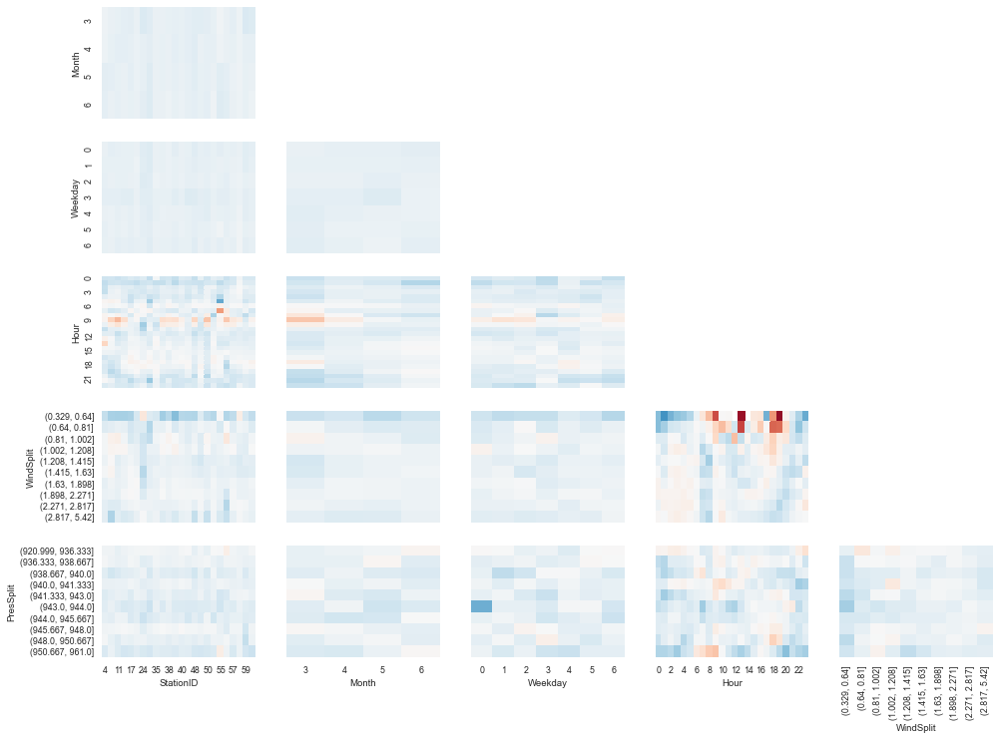

In [114]:
get_regions(train=train);

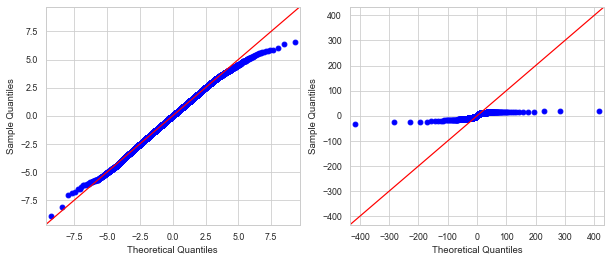

In [115]:
f, ax = plt.subplots(ncols = 2, figsize = (10,4))
sm.qqplot(train["ResidualsLog"], stats.t, fit=True, line="45", ax = ax[0])
sm.qqplot(train["Residuals"], stats.t, fit=True, line="45", ax = ax[1])
plt.show()

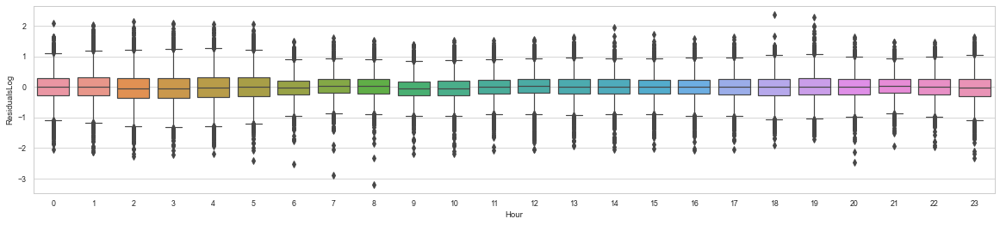

In [116]:
f, ax = plt.subplots(figsize = (20,4))
sns.boxplot(y = train["ResidualsLog"], x = train["Hour"], ax = ax)

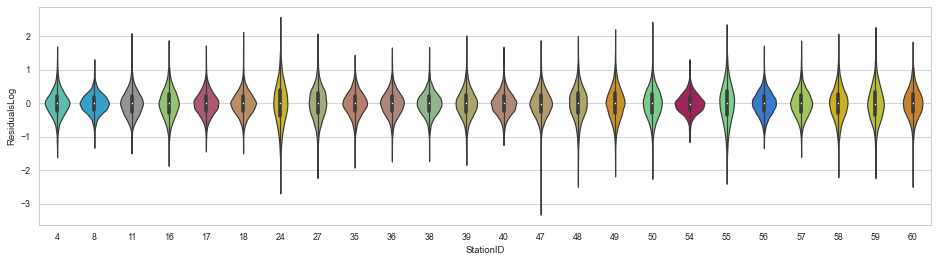

In [117]:
f, ax = plt.subplots(figsize = (16,4))
sns.violinplot(y = train["ResidualsLog"], x = train["StationID"], palette = palette_stations, ax = ax)

# 6. Effect of lockdown

The model is:

$\ln{y} = C_{lockdown}\delta_{lockdown}+f\left (pressure, wind, solar radiation, time \right)$

By undoing the logarithm:

$y = e^{C_{lockdown}\delta_{lockdown}}\cdot e^{f\left (pressure, wind, solar radiation, time \right)}$

Therefore $e^{C_{lockdown}}$ represents the effect of lockdown. If $e^{C_{lockdown}}<1$, then the lockdown decreased $NO_2$ levels. Otherwhise it increased them. The lower the value of $e^{C_{lockdown}}<1$ the higher the impact. 

In [118]:
all_intercepts = []
for key1 in model_dict:
    model_station = model_dict[key1]
    for key2 in model_station:
        model_month = model_station[key2]
        for key3 in model_month:
            row = []
            model_weekday = model_month[key3]
            row.append(key1)
            row.append(key2)
            row.append(key3)
            row.append(model_dict[key1][key2][key3].params.loc["Lockdown"])
            all_intercepts.append(row)

In [119]:
all_intercepts = pd.DataFrame(all_intercepts, columns = ["StationID","Month","Weekday","Lockdown"])
all_intercepts["Lockdown"] = np.exp(all_intercepts["Lockdown"])

In [120]:
all_intercepts["Hue"] = np.nan
i = 0
for station in all_intercepts["StationID"].unique():
    all_intercepts.loc[all_intercepts["StationID"]==station,"Hue"] = palette_stations[i]
    i = i + 1

In [121]:
all_intercepts

,StationID,Month,Weekday,Lockdown,Hue
0,4,3,4,1.000000,#4dceb8
1,4,3,5,1.000000,#4dceb8
2,4,3,6,1.000000,#4dceb8
3,4,3,0,1.000000,#4dceb8
4,4,3,1,1.000000,#4dceb8
...,...,...,...,...,...
667,56,6,6,0.425957,#e38711
668,56,6,0,0.618450,#e38711
669,56,6,1,0.675395,#e38711
670,56,6,2,0.846203,#e38711


## 6.1. Global effect

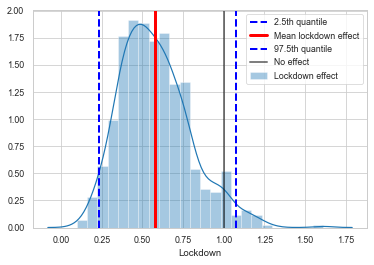

In [122]:
f, ax = plt.subplots()
sns.distplot(all_intercepts["Lockdown"], bins = 24, ax = ax, label = "Lockdown effect")
ax.axvline(x=all_intercepts["Lockdown"].quantile(0.025), label = "2.5th quantile", color = "blue", lw = 2, ls = "--")
ax.axvline(x=all_intercepts["Lockdown"].mean(), label = "Mean lockdown effect", color = "red", lw = 3)
ax.axvline(x=all_intercepts["Lockdown"].quantile(0.975), label = "97.5th quantile", color = "blue", lw = 2, ls = "--")
ax.axvline(x=1, label = "No effect", color = "black", lw = 2, alpha = 0.5)
plt.legend()

In [123]:
all_intercepts["Lockdown"].mean()

0.5791187256408011

In [124]:
all_intercepts["Lockdown"].quantile([0.025,0.975])

0.025    0.230674
0.975    1.073537
Name: Lockdown, dtype: float64

The 95% confidence interval shows that values of $e^{C_{lockdown}}$ are below 1, meaning that lockdown did indeed reduce $NO_2$ levels. 

## 6.2. Effect on each station

In [125]:
def drawlines(data, **kws):
    ax = plt.gca()
    ax.axvline(x=np.quantile(data["Lockdown"],0.025), label = "2.5th quantile", color = "blue", lw = 2, ls = "--", alpha = 0.5)
    ax.axvline(x=np.mean(data["Lockdown"]), label = "Mean", color = "red", lw = 2, alpha = 0.5)
    ax.axvline(x=np.quantile(data["Lockdown"],0.975), label = "97.5th quantile", color = "blue", lw = 2, ls = "--", alpha = 0.5)
    ax.axvline(x=1, label = "No effect", color = "black", lw = 2, alpha = 0.5)
    ax.set_xlim([0,1.5])
    ax.legend()

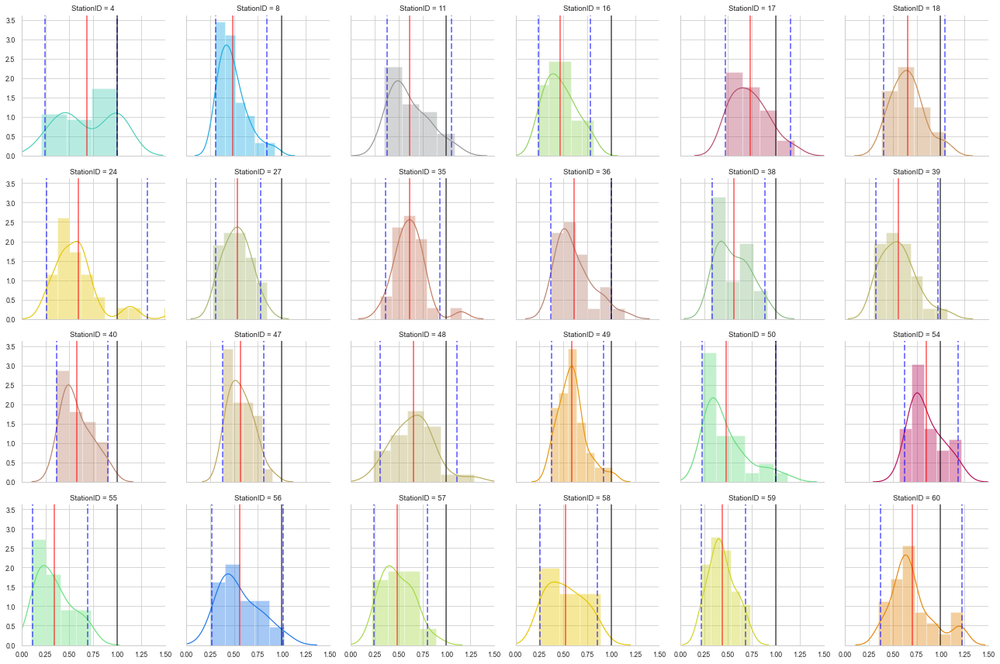

In [126]:
g = sns.FacetGrid(all_intercepts, col="StationID", col_wrap = 6, hue = "StationID", palette = palette_stations)
g.map(sns.distplot, "Lockdown")
g.map_dataframe(drawlines)

## 6.3. Maximum effect

Evaluating the percentage of decrease:

In [127]:
all_intercepts["Lockdown"] = 1 - all_intercepts["Lockdown"]

In [128]:
order = all_intercepts.groupby("StationID").mean().reset_index().sort_values("Lockdown")

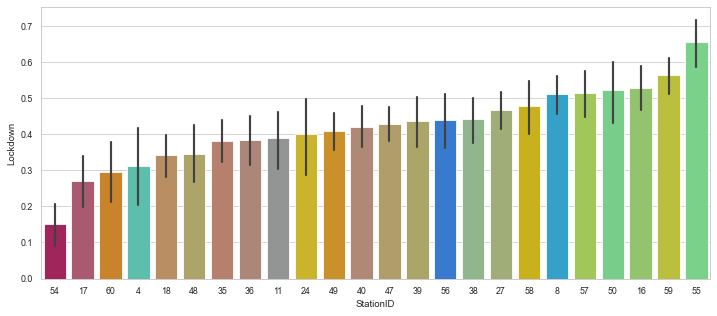

In [129]:
lockdown_effect = all_intercepts.groupby("StationID").mean().reset_index().sort_values("Lockdown")
f, ax = plt.subplots(figsize = (12,5))
sns.barplot(x = all_intercepts["StationID"], y = all_intercepts["Lockdown"], order = lockdown_effect["StationID"], 
            palette = [palette_stations[i] for i in order.index], ax = ax)

The most affected station is stations 55, located at Madrid's  airport. The effect was higher on stations in the north (richer, less populated) than in the south (poorer, highly populated). 